In [1]:
import helper

data_dir = '../data/'

## Explore the Data

In [2]:
show_n_images = 25
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

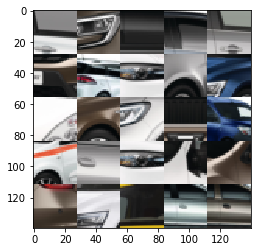

In [3]:
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'renault/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

In [4]:
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.5.0


/Users/az02210/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: UserWarning: No GPU found. Please use a GPU to train your neural network.
  # This is added back by InteractiveShellApp.init_path()


In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    input_real = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], "input_real")
    input_z = tf.placeholder(tf.float32, [None, z_dim], "input_z")
    learning_rate = tf.placeholder(tf.float32, None, "learning_rate")

    return input_real, input_z, learning_rate

### Discriminator

In [6]:
def discriminator(images, reuse=False, alpha=0.01):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding="same", kernel_initializer=tf.contrib.layers.xavier_initializer())
        relu1 = tf.maximum(alpha * x1, x1)

        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding="same", kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        d2 = tf.nn.dropout(relu2, 0.8)

        x3 = tf.layers.conv2d(d2, 256, 5, strides=2, padding="same", kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        d3 = tf.nn.dropout(relu3, 0.8)

        flat = tf.reshape(d3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return out, logits

### Generator

In [7]:
def generator(z, out_channel_dim, is_train=True, alpha=0.01):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    with tf.variable_scope("generator", reuse=not is_train):
        x1 = tf.layers.dense(z, 4*4*256)
        x1 = tf.reshape(x1, (-1, 4, 4, 256))
        x1 = tf.layers.dense(z, 7*7*512)
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        relu1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(relu1, 256, 5, 2, 'same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn2 = tf.layers.batch_normalization(x2, training=is_train)
        relu2 = tf.maximum(alpha * bn2, bn2)
        d2 = tf.nn.dropout(relu2, 0.8)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, 2, 'same', kernel_initializer=tf.contrib.layers.xavier_initializer())
        bn3 = tf.layers.batch_normalization(x3, training=is_train)
        relu3 = tf.maximum(alpha * bn3, bn3)
        d3 = tf.nn.dropout(relu3, 0.8)
        
        logits = tf.layers.conv2d_transpose(d3, out_channel_dim, 5, 1, 'same')
        out = tf.tanh(logits)

        return out

### Loss

In [8]:
def model_loss(input_real, input_z, out_channel_dim, alpha=0.9):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_logits_real) * alpha))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_logits_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_logits_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

### Optimization

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Neural Network Training
### Show Output

In [10]:
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    dis, gen, f1 = [], [], []
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            steps = 0
            for batch_images in get_batches(batch_size):
                steps +=1
                batch_images = batch_images * 2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                train_loss_d = d_loss.eval({input_real: batch_images, input_z: batch_z})
                train_loss_g = g_loss.eval({input_z: batch_z})
                dis.append(train_loss_d)
                gen.append(train_loss_g)
                val = (train_loss_d + train_loss_g) / 2
                f1.append(val)
                if steps % 20 == 0:

                    print("Epoch {}/{}...".format(epoch_i+1, epochs),
                          "Batch {}...".format(steps),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))

                if steps % 5 == 0:
                    show_generator_output(sess, show_n_images, input_z, data_shape[3], data_image_mode)
    return dis, gen, f1

### Renault DataSet

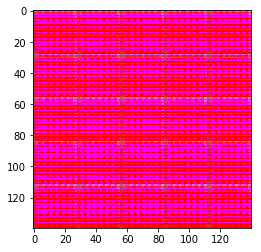

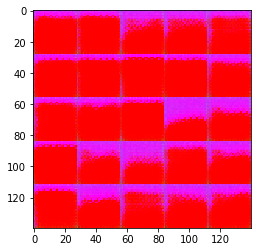

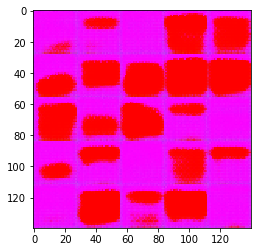

Epoch 1/50... Batch 20... Discriminator Loss: 0.3700... Generator Loss: 6.4278


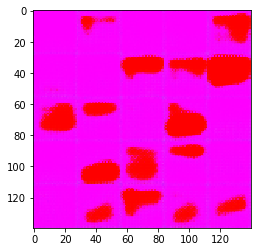

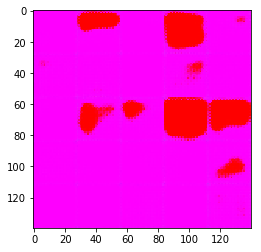

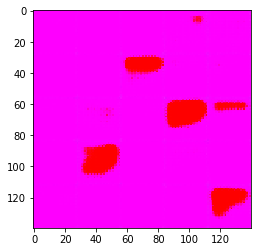

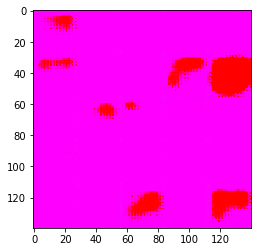

Epoch 1/50... Batch 40... Discriminator Loss: 0.3358... Generator Loss: 9.1770


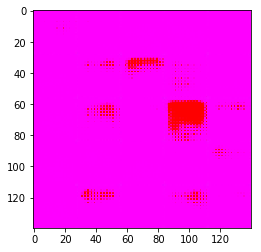

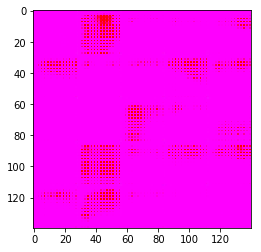

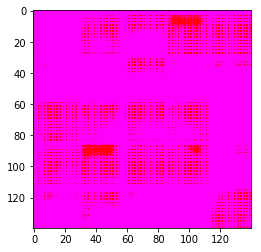

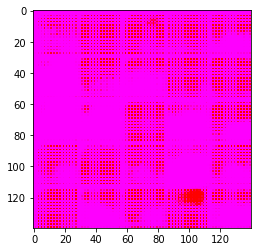

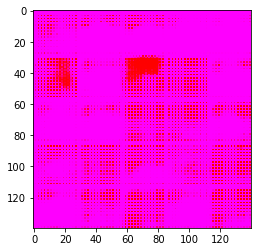

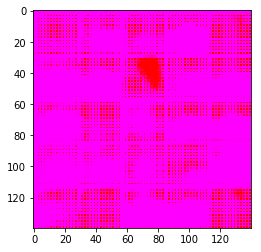

Epoch 2/50... Batch 20... Discriminator Loss: 0.3499... Generator Loss: 8.2892


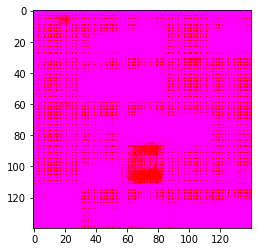

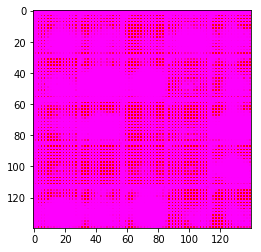

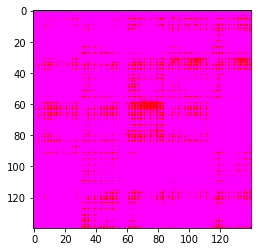

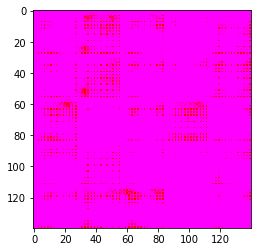

Epoch 2/50... Batch 40... Discriminator Loss: 0.3346... Generator Loss: 7.9856


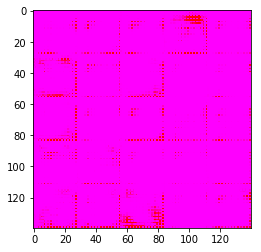

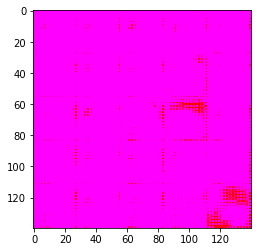

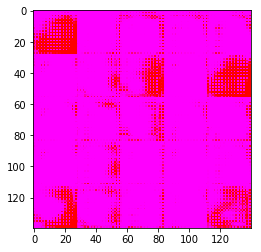

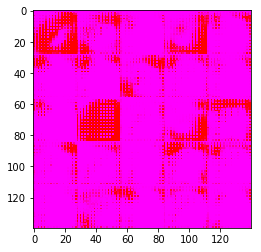

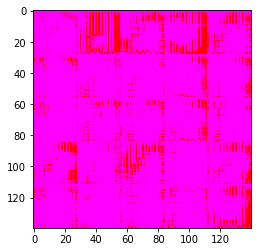

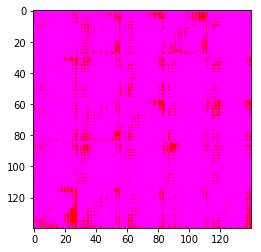

Epoch 3/50... Batch 20... Discriminator Loss: 0.3363... Generator Loss: 9.0716


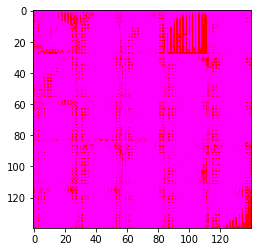

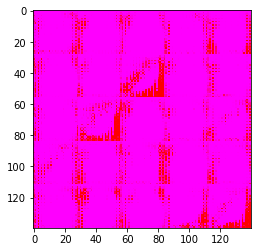

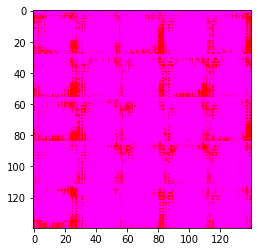

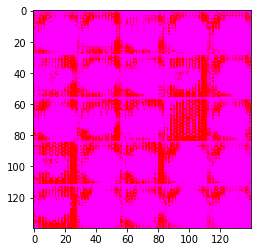

Epoch 3/50... Batch 40... Discriminator Loss: 0.3727... Generator Loss: 7.6107


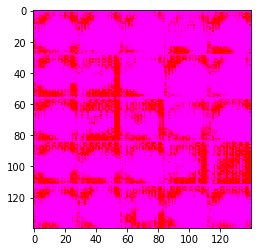

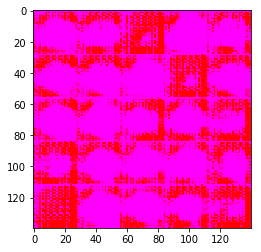

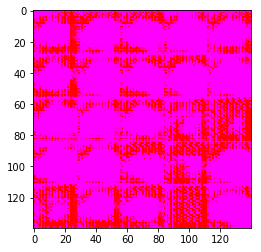

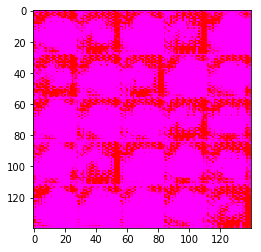

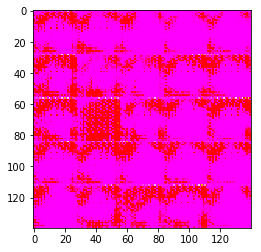

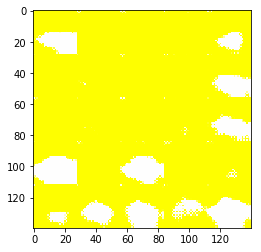

Epoch 4/50... Batch 20... Discriminator Loss: 0.5390... Generator Loss: 10.6215


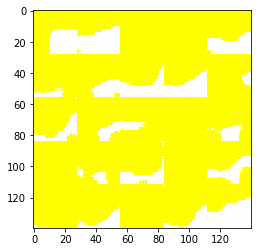

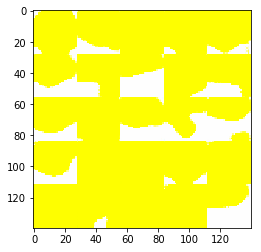

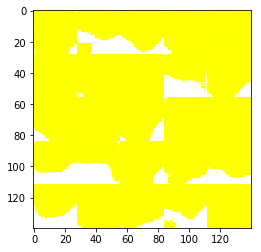

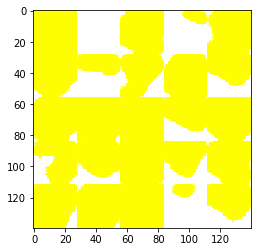

Epoch 4/50... Batch 40... Discriminator Loss: 0.3884... Generator Loss: 11.6832


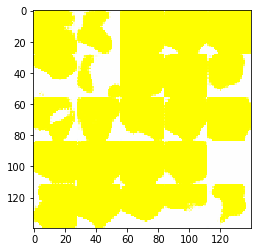

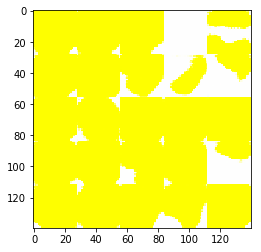

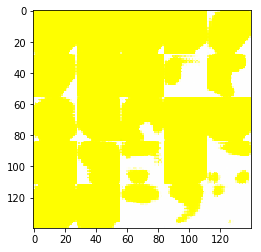

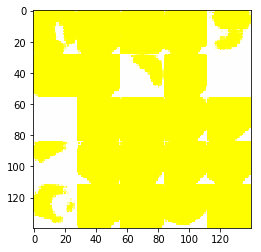

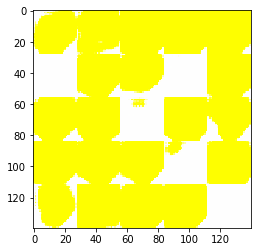

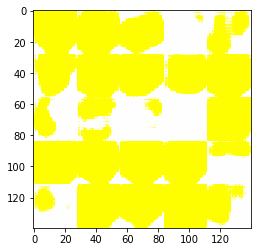

Epoch 5/50... Batch 20... Discriminator Loss: 0.3372... Generator Loss: 9.8627


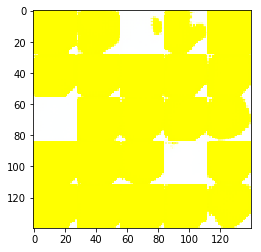

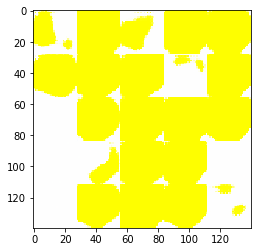

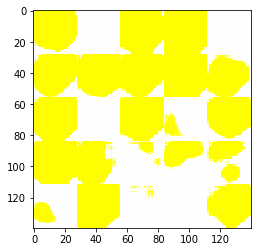

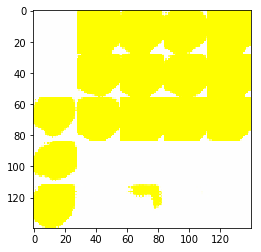

Epoch 5/50... Batch 40... Discriminator Loss: 0.3420... Generator Loss: 9.2785


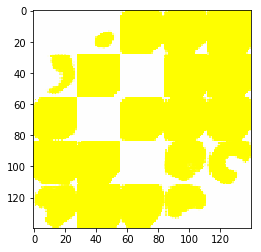

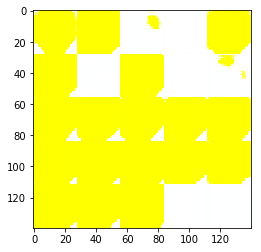

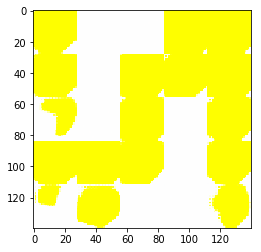

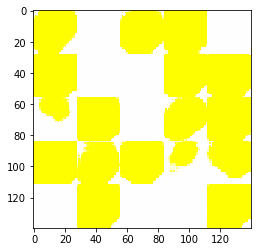

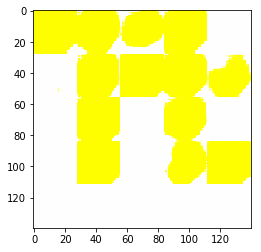

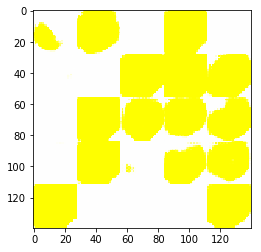

Epoch 6/50... Batch 20... Discriminator Loss: 0.3430... Generator Loss: 9.5935


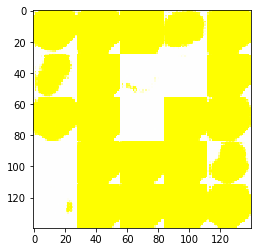

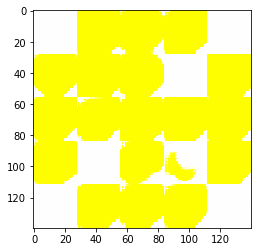

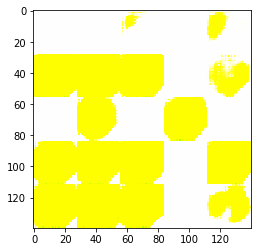

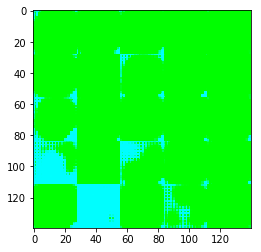

Epoch 6/50... Batch 40... Discriminator Loss: 0.5387... Generator Loss: 8.7038


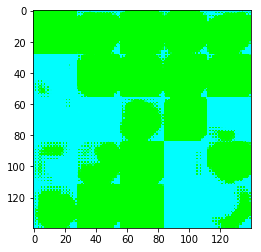

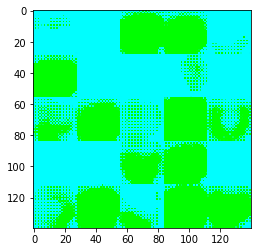

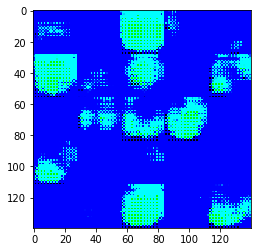

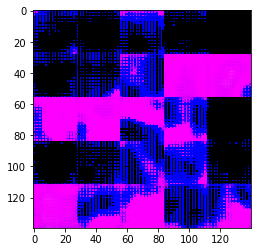

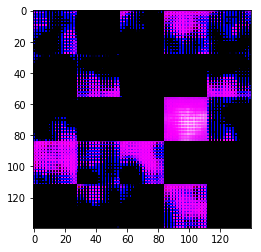

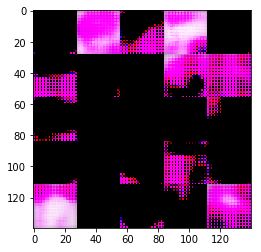

Epoch 7/50... Batch 20... Discriminator Loss: 0.6636... Generator Loss: 2.7284


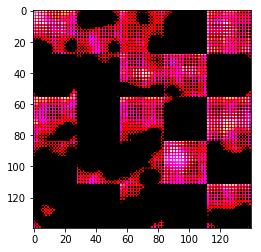

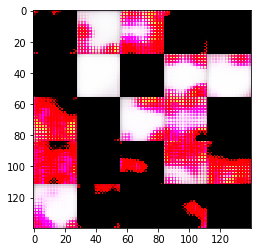

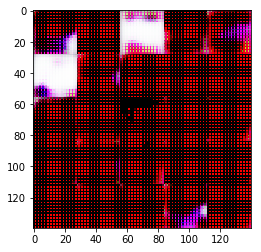

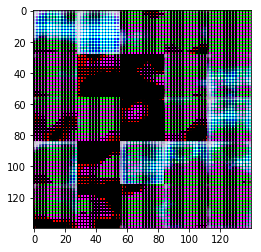

Epoch 7/50... Batch 40... Discriminator Loss: 0.5701... Generator Loss: 3.5077


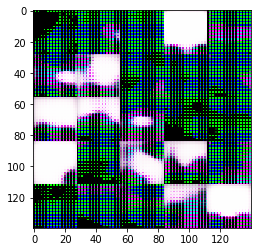

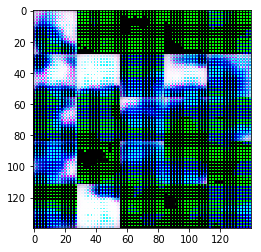

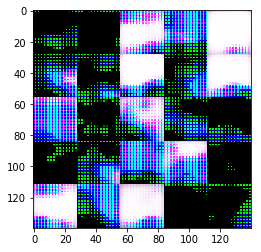

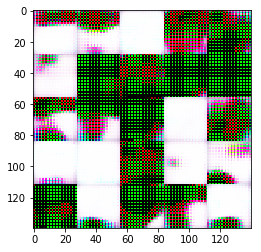

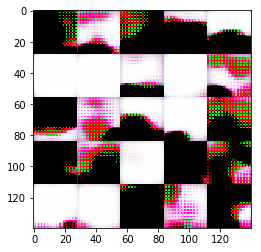

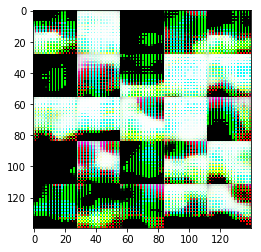

Epoch 8/50... Batch 20... Discriminator Loss: 0.9187... Generator Loss: 1.7297


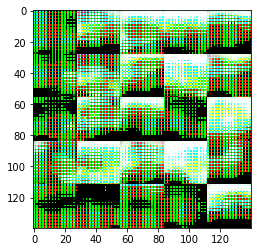

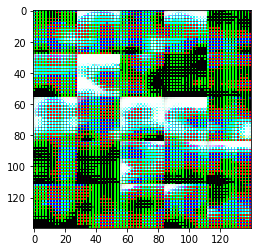

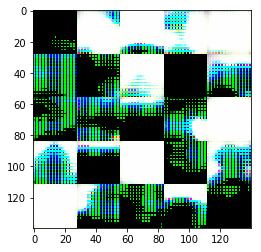

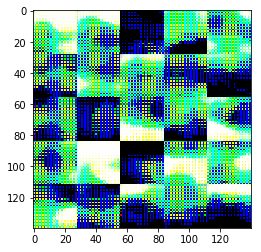

Epoch 8/50... Batch 40... Discriminator Loss: 0.3795... Generator Loss: 3.6657


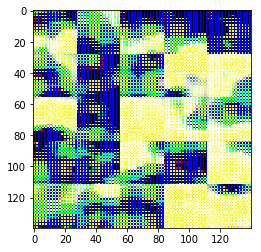

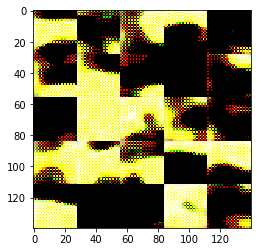

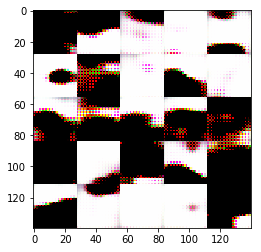

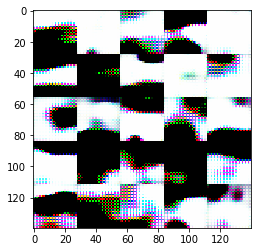

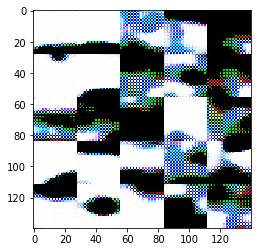

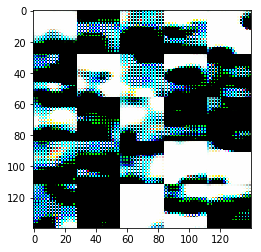

Epoch 9/50... Batch 20... Discriminator Loss: 0.3802... Generator Loss: 4.1840


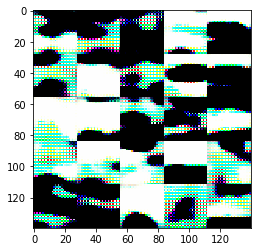

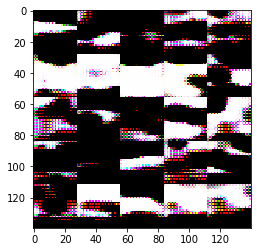

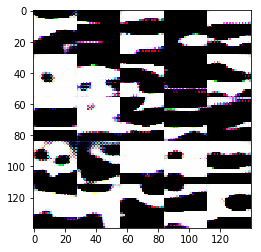

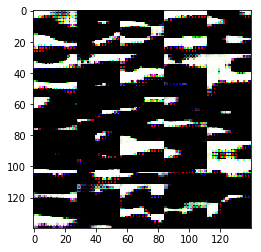

Epoch 9/50... Batch 40... Discriminator Loss: 0.4092... Generator Loss: 3.3461


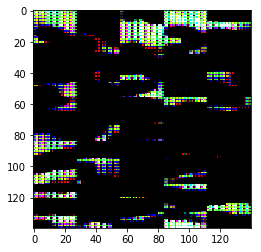

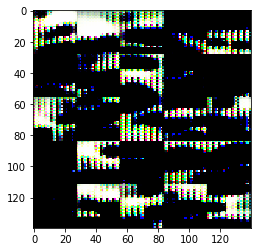

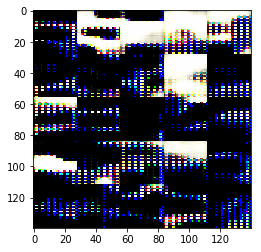

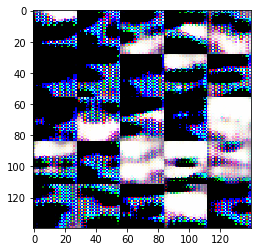

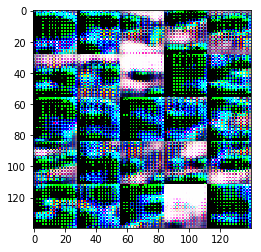

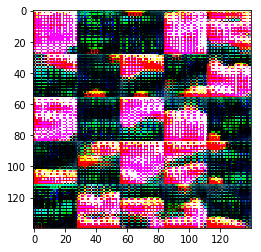

Epoch 10/50... Batch 20... Discriminator Loss: 0.8260... Generator Loss: 1.2449


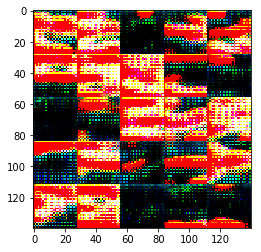

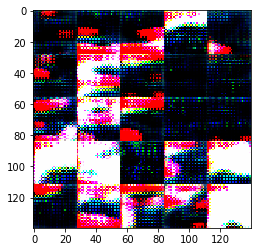

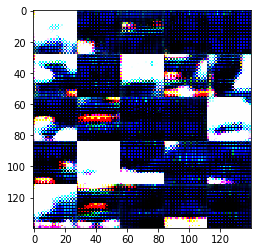

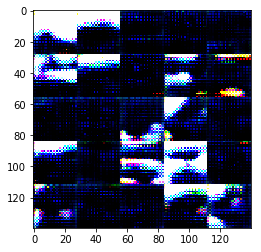

Epoch 10/50... Batch 40... Discriminator Loss: 0.4939... Generator Loss: 2.5241


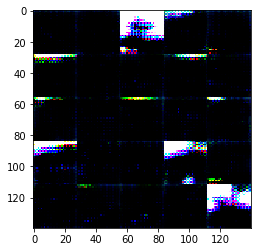

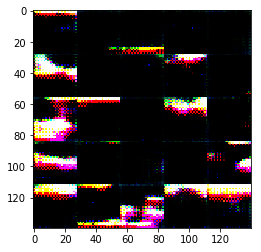

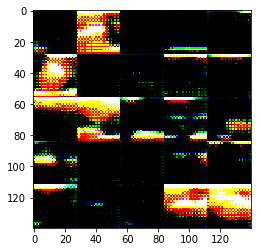

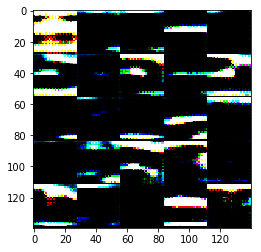

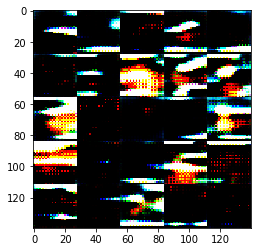

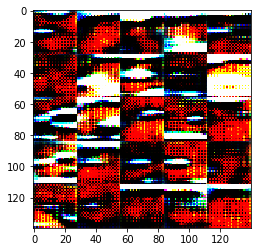

Epoch 11/50... Batch 20... Discriminator Loss: 0.3825... Generator Loss: 4.7638


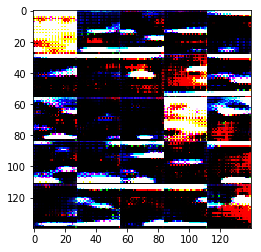

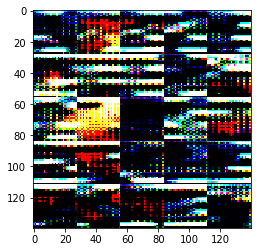

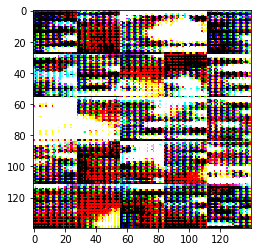

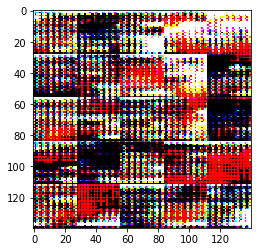

Epoch 11/50... Batch 40... Discriminator Loss: 0.3606... Generator Loss: 7.8553


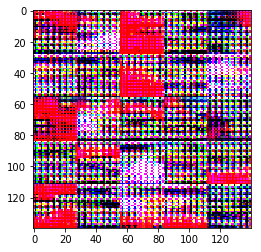

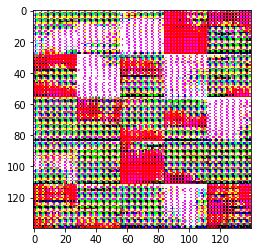

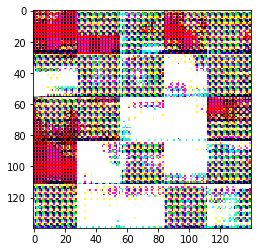

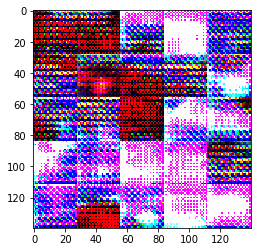

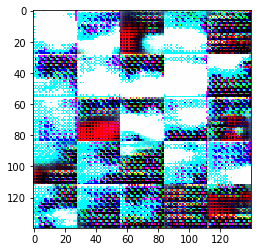

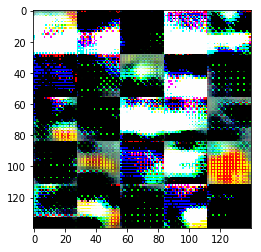

Epoch 12/50... Batch 20... Discriminator Loss: 1.9928... Generator Loss: 0.2593


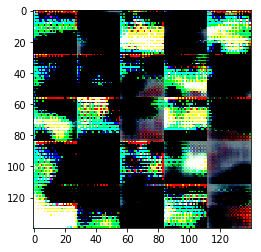

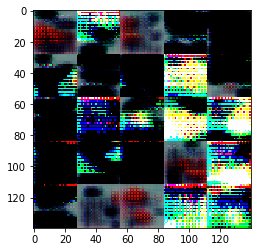

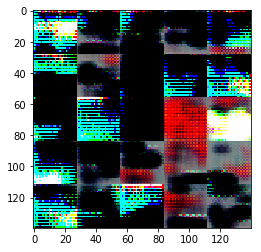

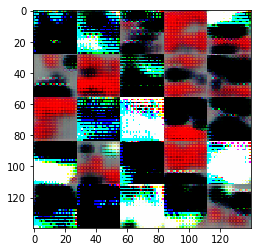

Epoch 12/50... Batch 40... Discriminator Loss: 0.9098... Generator Loss: 1.7221


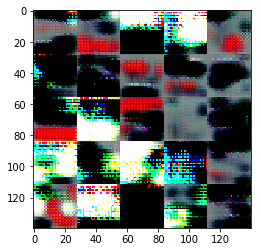

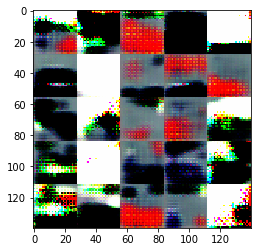

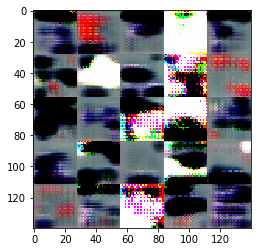

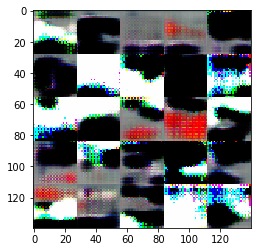

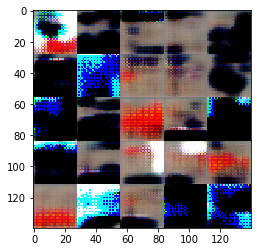

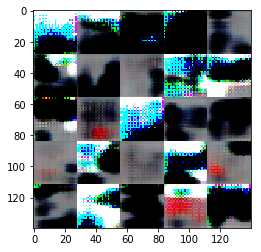

Epoch 13/50... Batch 20... Discriminator Loss: 1.2191... Generator Loss: 0.7479


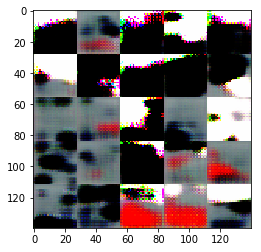

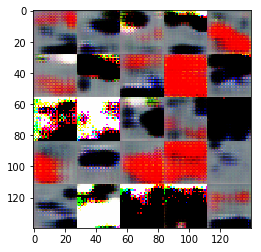

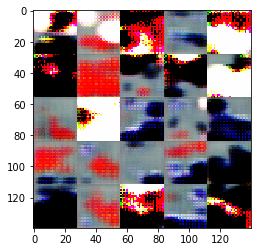

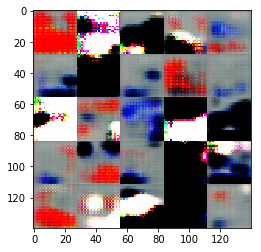

Epoch 13/50... Batch 40... Discriminator Loss: 1.0980... Generator Loss: 1.0689


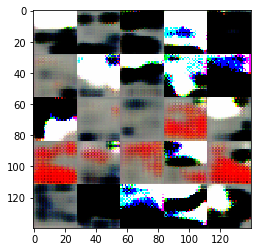

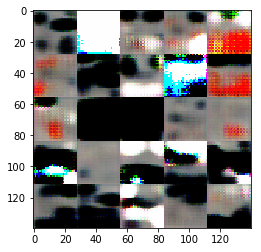

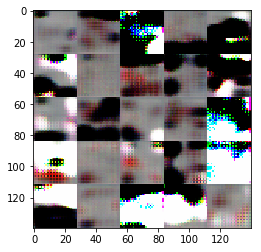

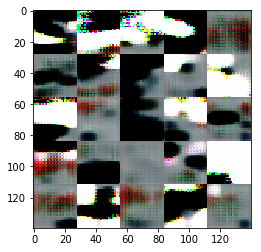

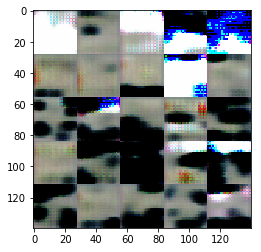

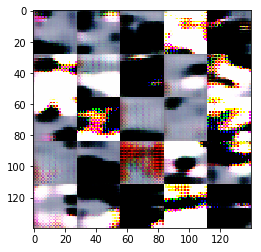

Epoch 14/50... Batch 20... Discriminator Loss: 1.1678... Generator Loss: 1.1161


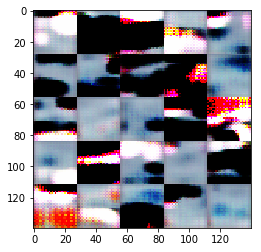

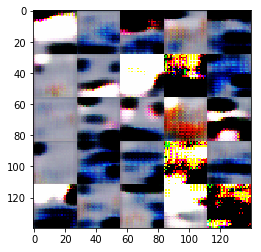

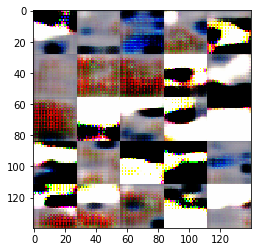

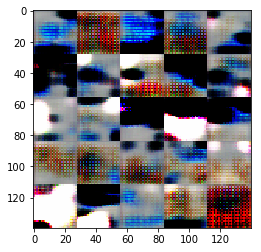

Epoch 14/50... Batch 40... Discriminator Loss: 1.0357... Generator Loss: 1.2008


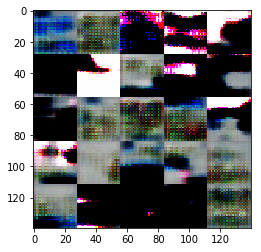

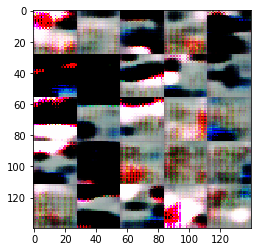

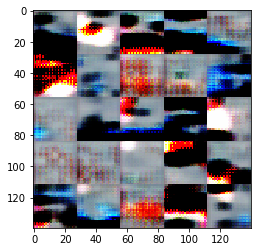

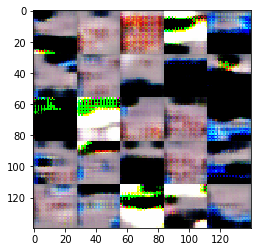

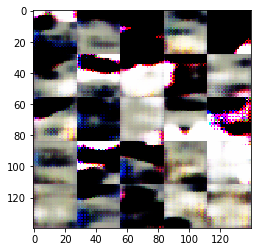

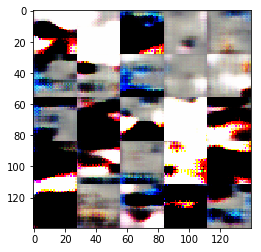

Epoch 15/50... Batch 20... Discriminator Loss: 1.2320... Generator Loss: 0.8619


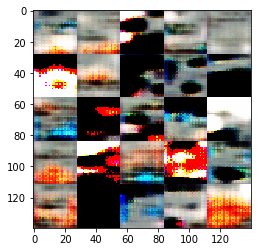

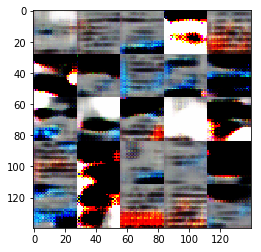

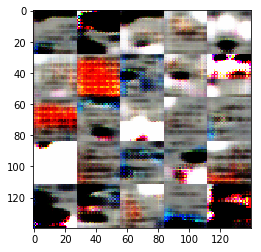

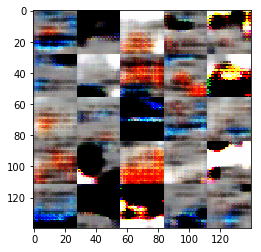

Epoch 15/50... Batch 40... Discriminator Loss: 1.0490... Generator Loss: 0.7678


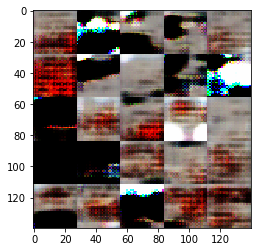

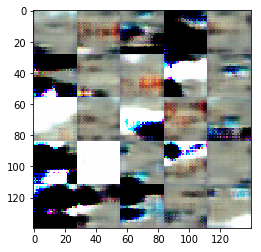

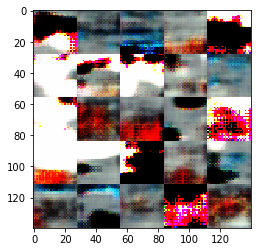

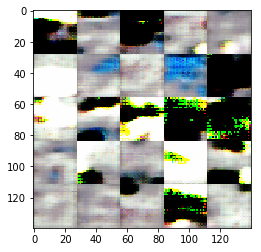

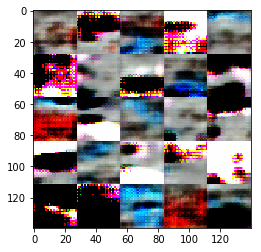

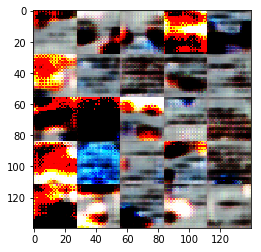

Epoch 16/50... Batch 20... Discriminator Loss: 1.3444... Generator Loss: 1.7720


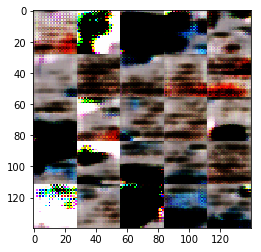

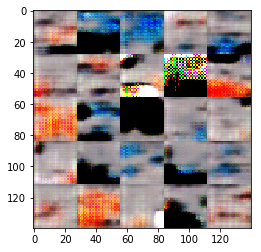

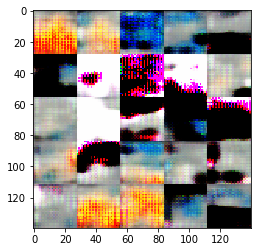

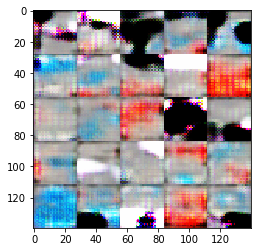

Epoch 16/50... Batch 40... Discriminator Loss: 0.9130... Generator Loss: 1.2586


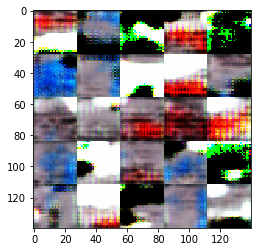

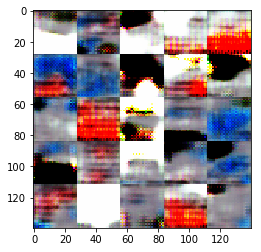

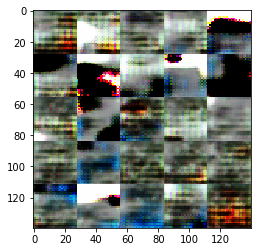

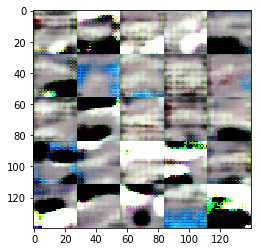

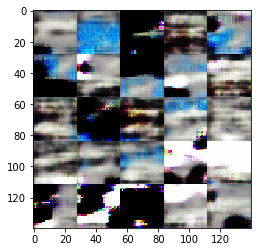

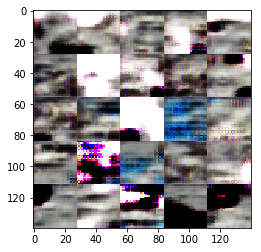

Epoch 17/50... Batch 20... Discriminator Loss: 1.4322... Generator Loss: 1.6137


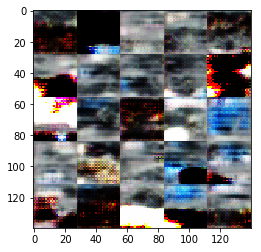

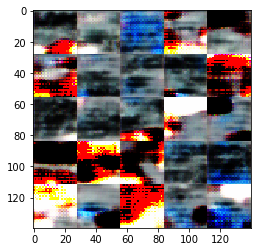

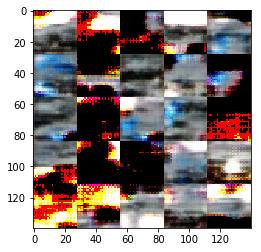

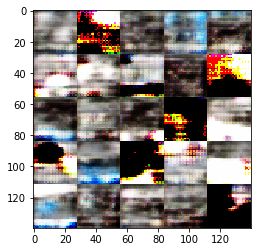

Epoch 17/50... Batch 40... Discriminator Loss: 1.1271... Generator Loss: 3.2786


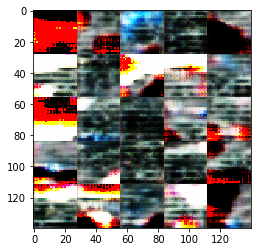

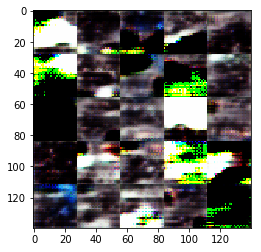

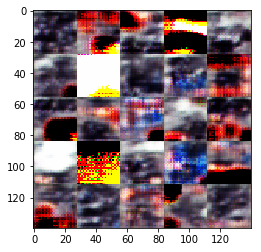

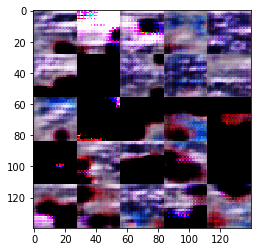

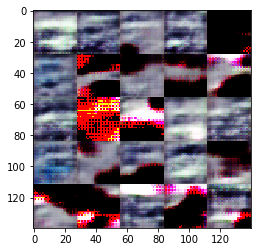

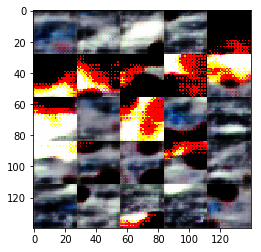

Epoch 18/50... Batch 20... Discriminator Loss: 1.0031... Generator Loss: 2.9596


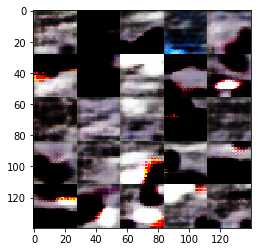

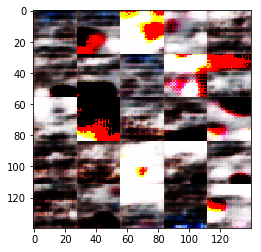

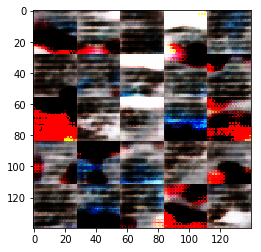

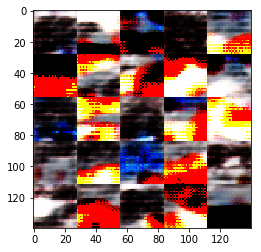

Epoch 18/50... Batch 40... Discriminator Loss: 0.9674... Generator Loss: 1.7993


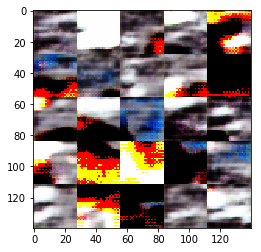

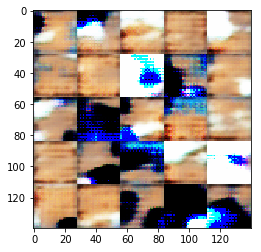

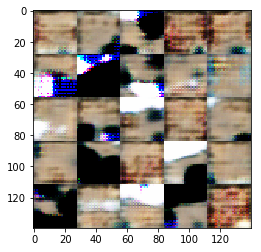

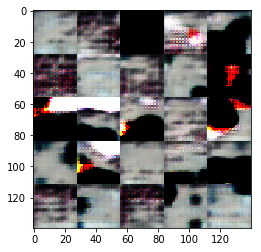

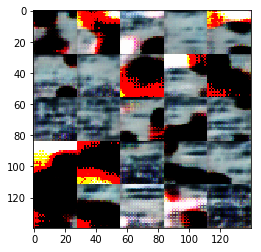

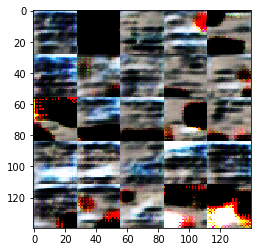

Epoch 19/50... Batch 20... Discriminator Loss: 1.0110... Generator Loss: 1.7857


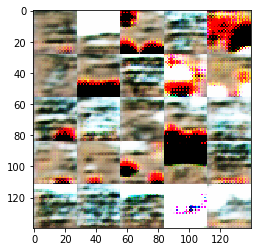

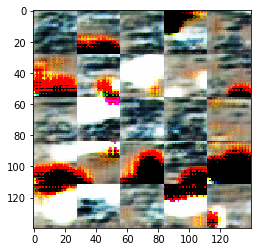

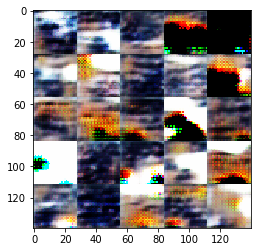

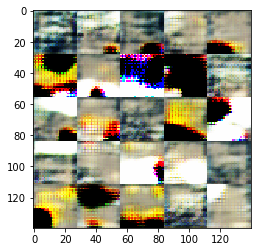

Epoch 19/50... Batch 40... Discriminator Loss: 0.9699... Generator Loss: 0.9707


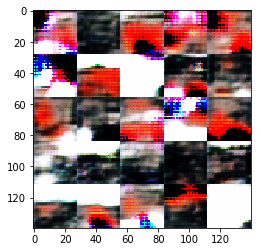

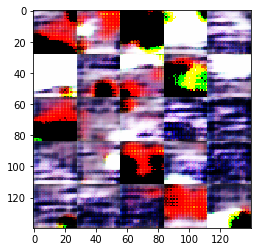

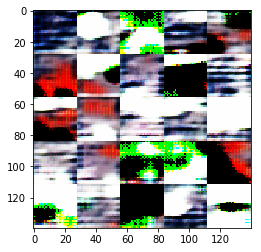

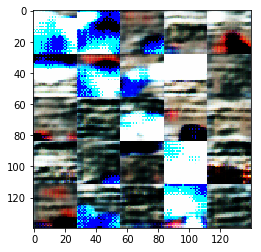

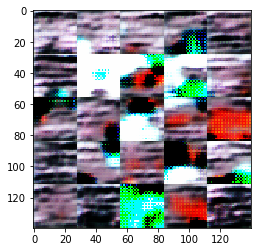

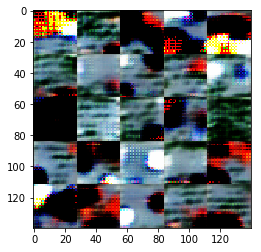

Epoch 20/50... Batch 20... Discriminator Loss: 0.5876... Generator Loss: 2.0418


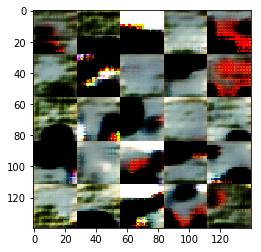

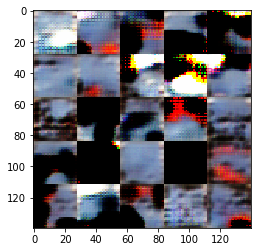

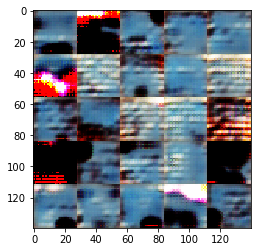

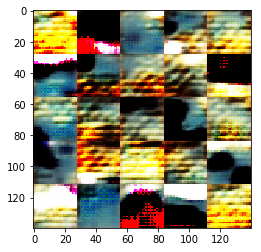

Epoch 20/50... Batch 40... Discriminator Loss: 1.6523... Generator Loss: 8.3439


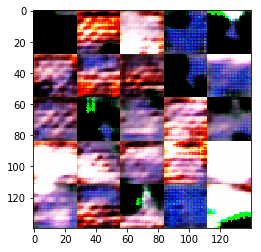

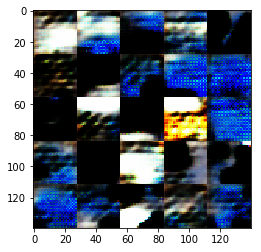

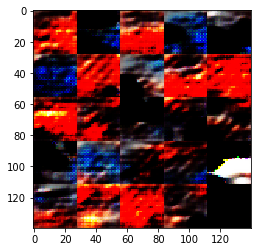

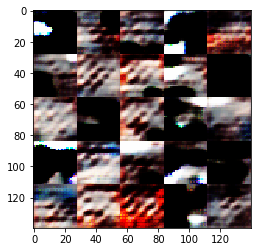

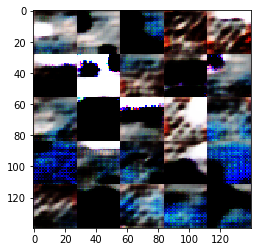

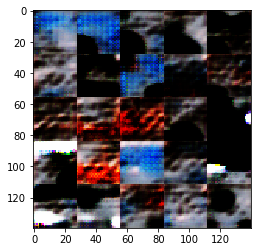

Epoch 21/50... Batch 20... Discriminator Loss: 1.1882... Generator Loss: 1.0428


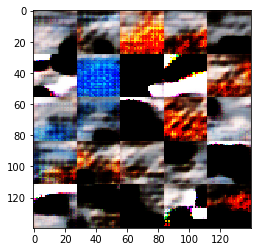

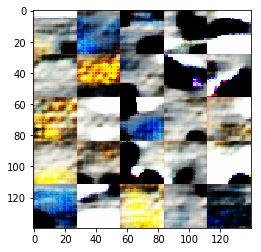

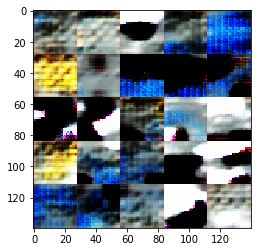

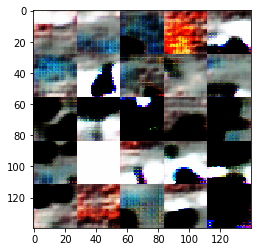

Epoch 21/50... Batch 40... Discriminator Loss: 0.9242... Generator Loss: 0.9534


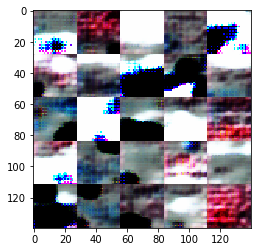

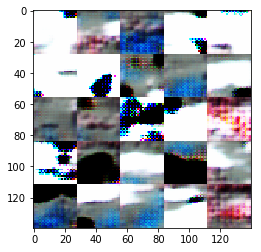

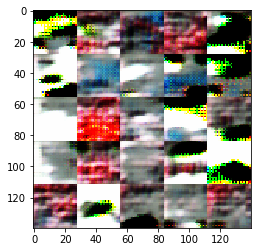

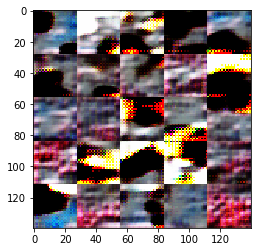

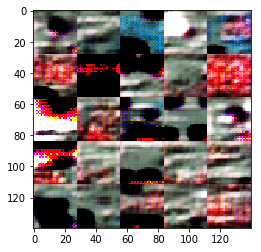

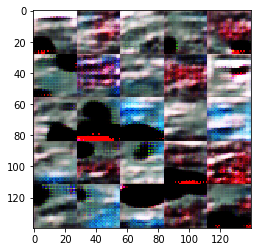

Epoch 22/50... Batch 20... Discriminator Loss: 0.9709... Generator Loss: 1.0614


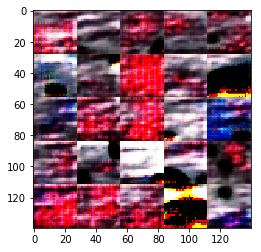

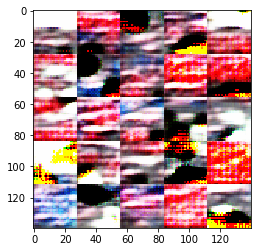

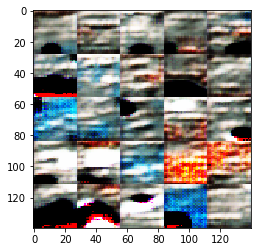

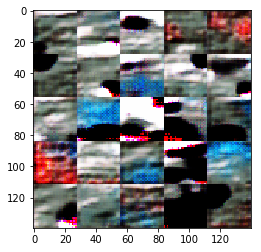

Epoch 22/50... Batch 40... Discriminator Loss: 0.6486... Generator Loss: 1.6690


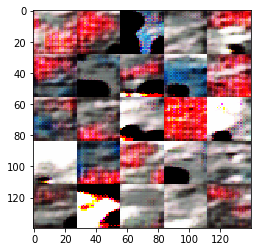

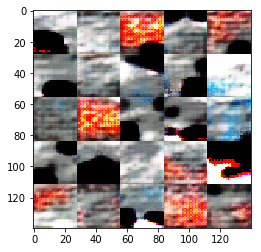

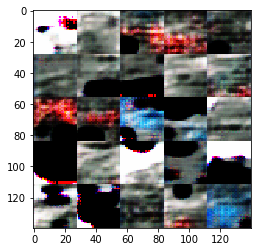

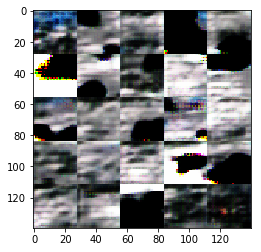

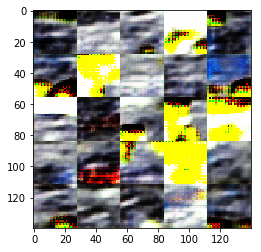

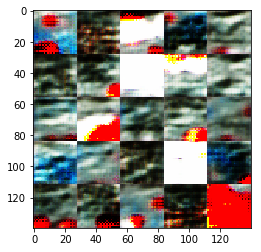

Epoch 23/50... Batch 20... Discriminator Loss: 0.5740... Generator Loss: 2.5573


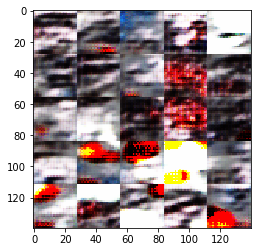

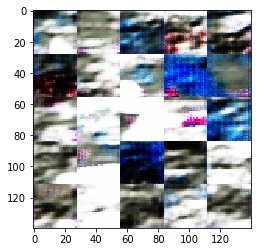

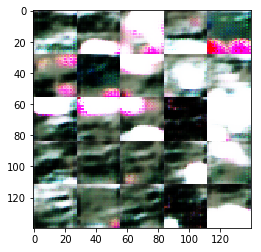

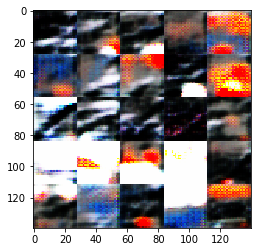

Epoch 23/50... Batch 40... Discriminator Loss: 0.6714... Generator Loss: 1.9808


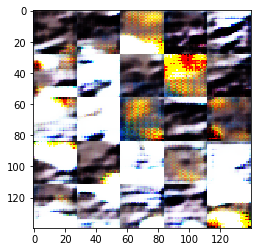

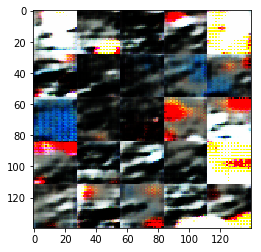

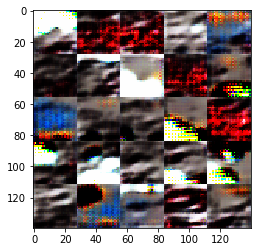

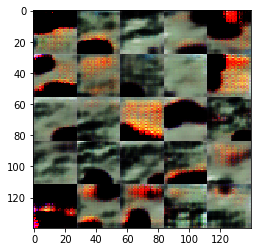

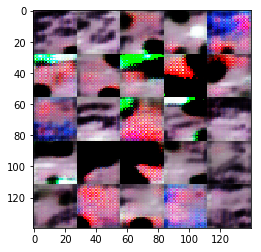

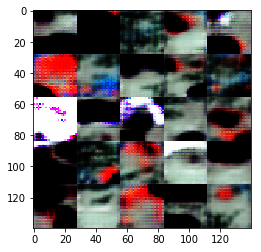

Epoch 24/50... Batch 20... Discriminator Loss: 0.9580... Generator Loss: 1.7412


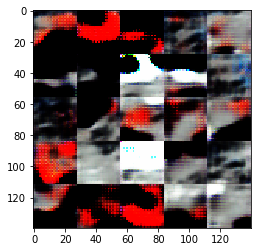

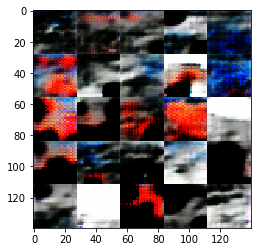

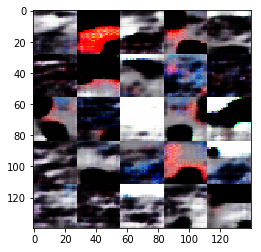

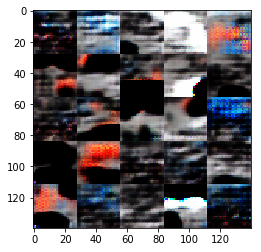

Epoch 24/50... Batch 40... Discriminator Loss: 0.6713... Generator Loss: 1.4692


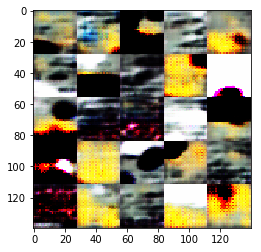

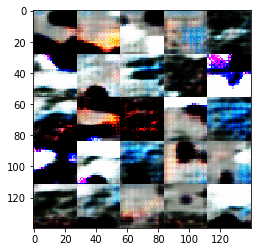

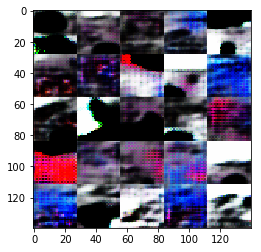

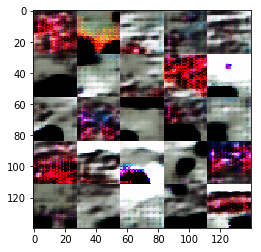

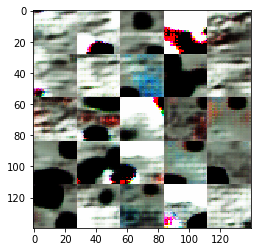

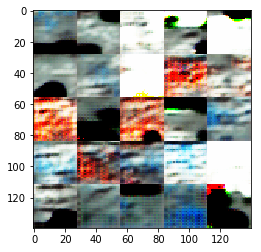

Epoch 25/50... Batch 20... Discriminator Loss: 0.6085... Generator Loss: 2.0153


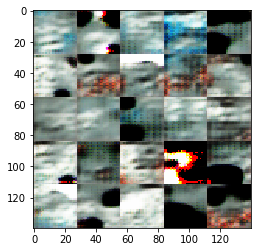

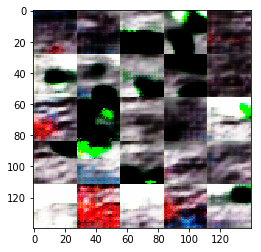

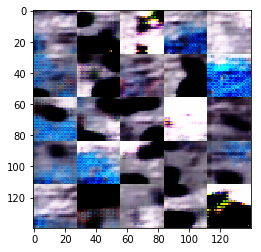

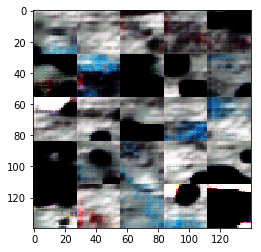

Epoch 25/50... Batch 40... Discriminator Loss: 0.6994... Generator Loss: 1.4701


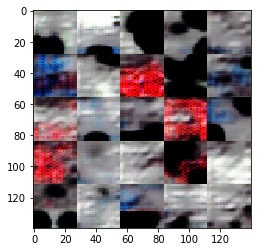

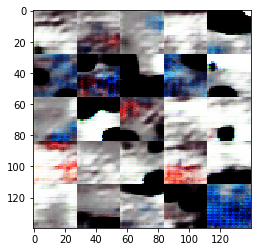

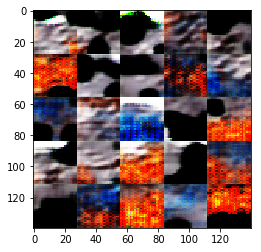

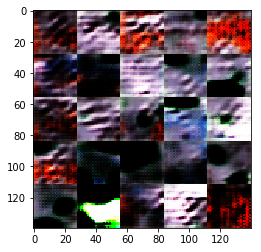

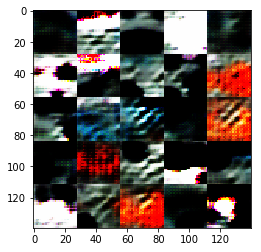

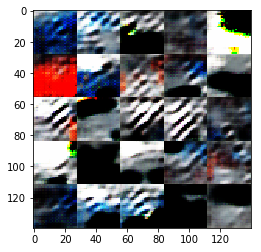

Epoch 26/50... Batch 20... Discriminator Loss: 0.6031... Generator Loss: 2.3731


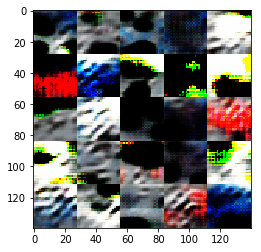

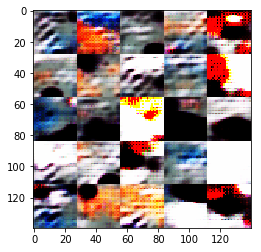

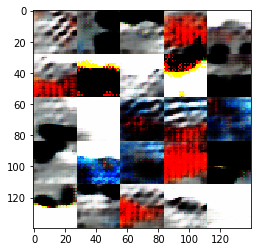

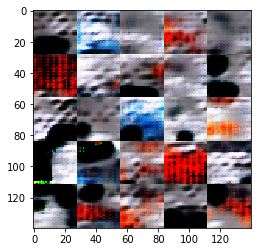

Epoch 26/50... Batch 40... Discriminator Loss: 0.9541... Generator Loss: 0.8526


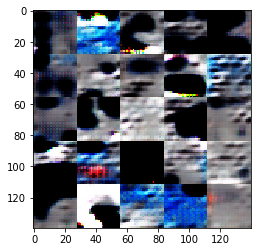

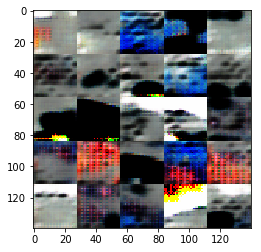

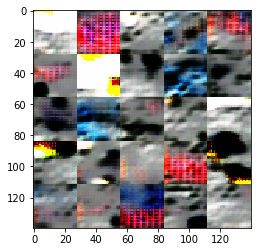

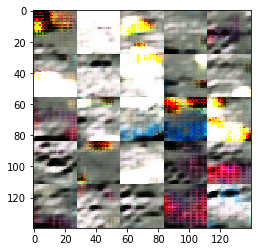

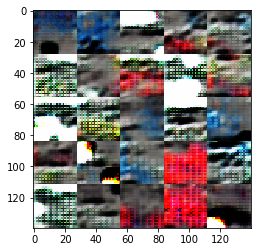

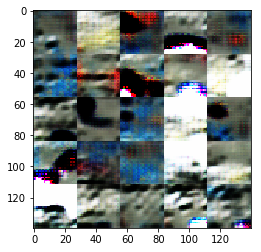

Epoch 27/50... Batch 20... Discriminator Loss: 0.4686... Generator Loss: 3.1584


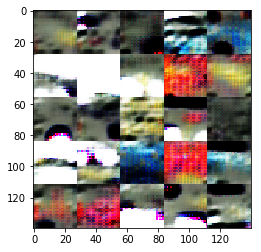

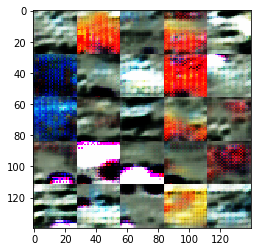

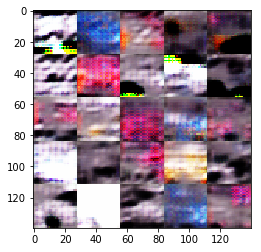

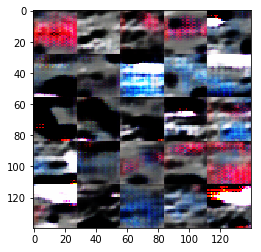

Epoch 27/50... Batch 40... Discriminator Loss: 1.0416... Generator Loss: 1.0351


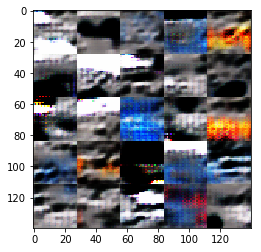

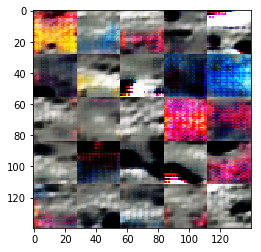

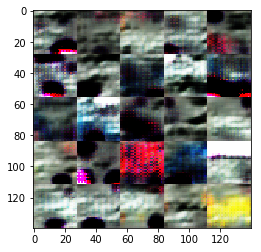

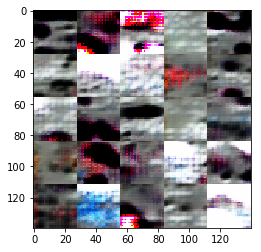

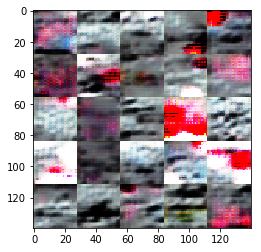

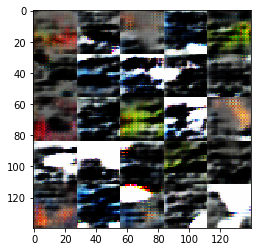

Epoch 28/50... Batch 20... Discriminator Loss: 0.7333... Generator Loss: 1.1896


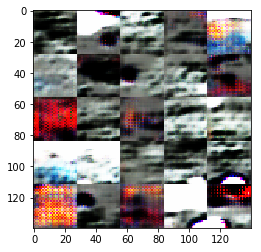

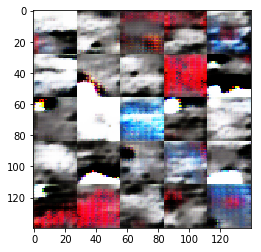

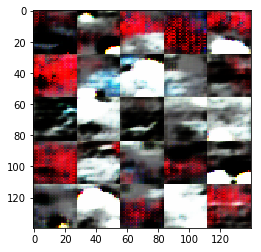

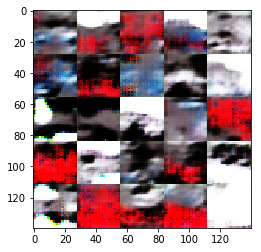

Epoch 28/50... Batch 40... Discriminator Loss: 0.4061... Generator Loss: 3.7827


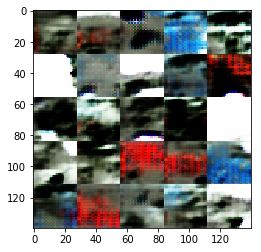

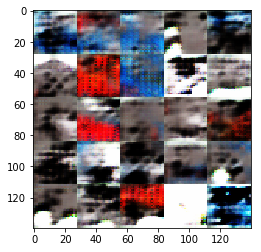

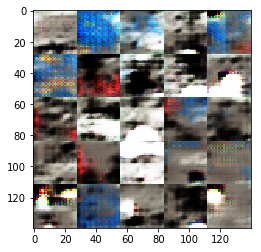

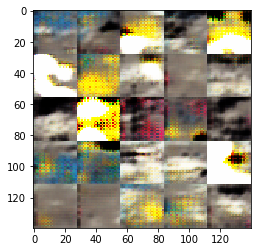

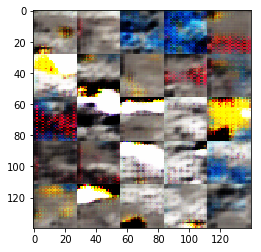

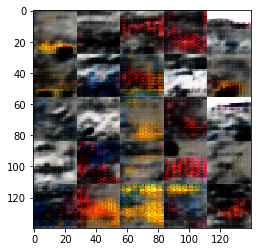

Epoch 29/50... Batch 20... Discriminator Loss: 2.3821... Generator Loss: 0.3625


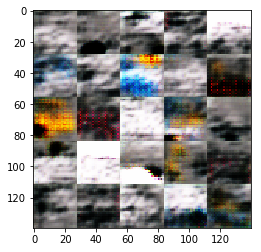

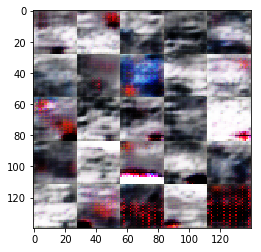

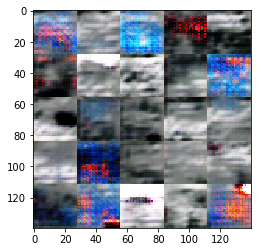

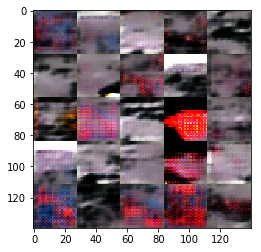

Epoch 29/50... Batch 40... Discriminator Loss: 0.5820... Generator Loss: 1.9858


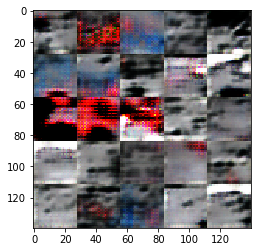

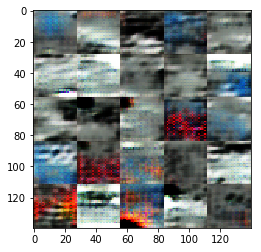

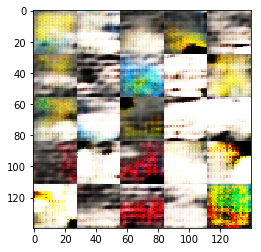

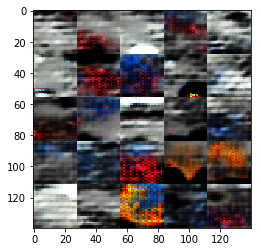

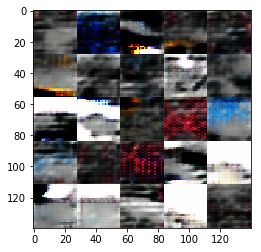

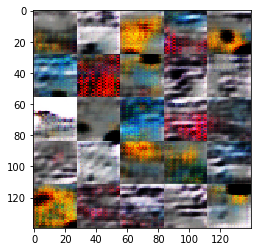

Epoch 30/50... Batch 20... Discriminator Loss: 1.4043... Generator Loss: 0.7530


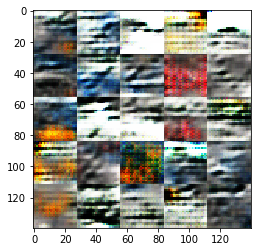

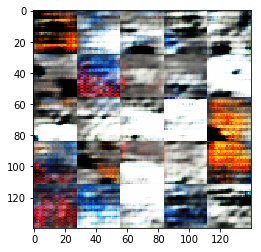

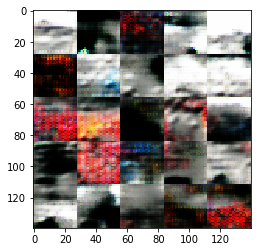

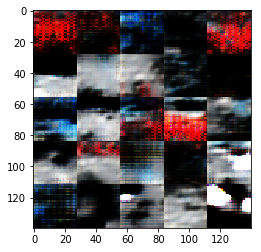

Epoch 30/50... Batch 40... Discriminator Loss: 0.6919... Generator Loss: 1.8344


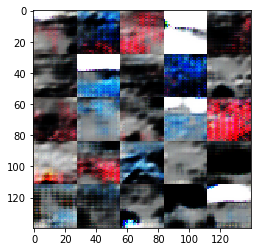

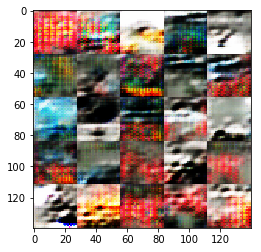

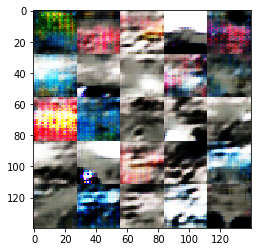

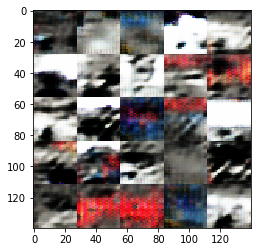

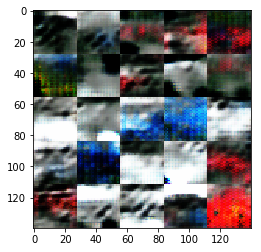

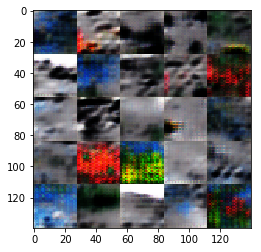

Epoch 31/50... Batch 20... Discriminator Loss: 0.8166... Generator Loss: 1.4082


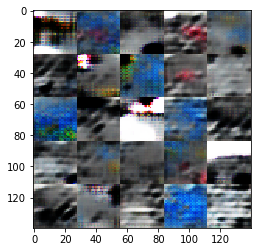

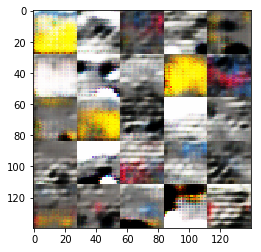

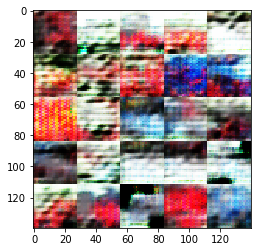

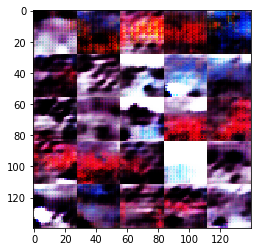

Epoch 31/50... Batch 40... Discriminator Loss: 0.8477... Generator Loss: 1.1943


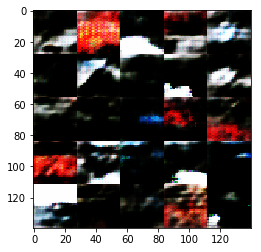

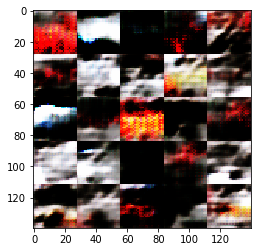

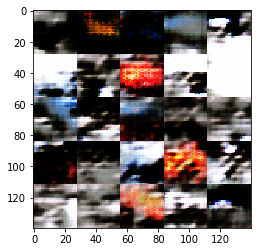

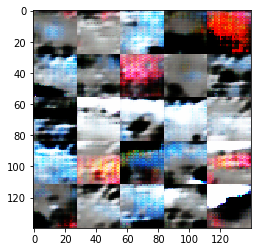

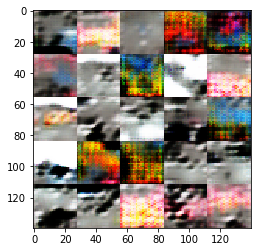

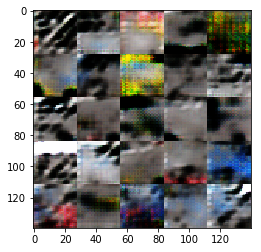

Epoch 32/50... Batch 20... Discriminator Loss: 0.9173... Generator Loss: 1.5458


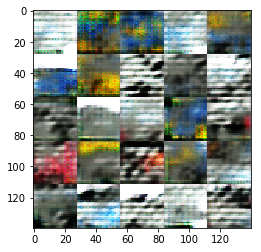

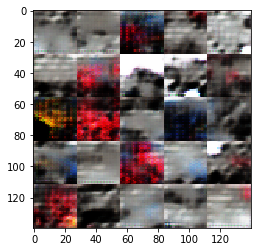

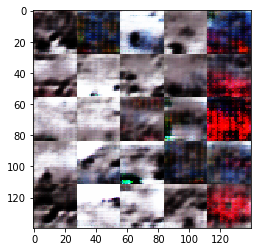

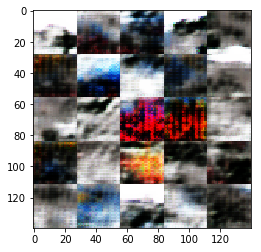

Epoch 32/50... Batch 40... Discriminator Loss: 0.7776... Generator Loss: 1.4387


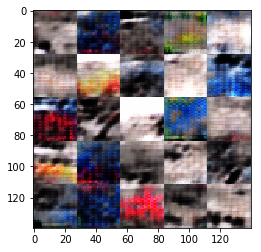

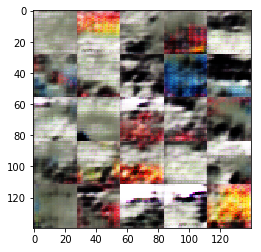

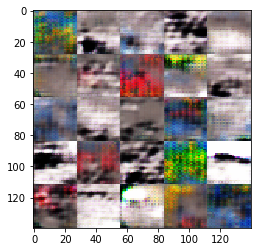

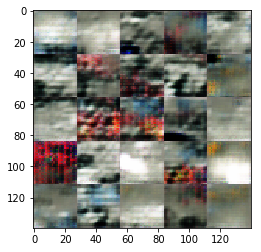

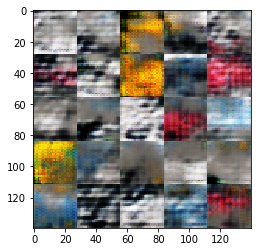

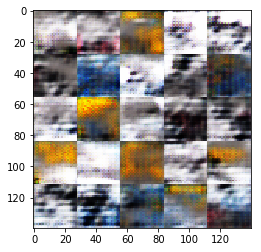

Epoch 33/50... Batch 20... Discriminator Loss: 0.5449... Generator Loss: 4.0681


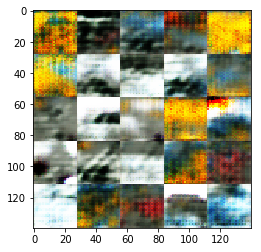

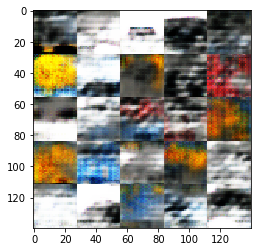

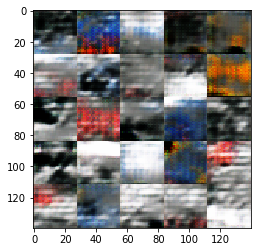

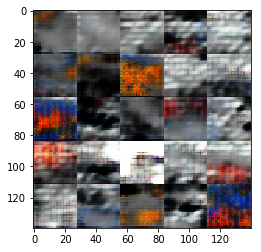

Epoch 33/50... Batch 40... Discriminator Loss: 0.8900... Generator Loss: 0.9888


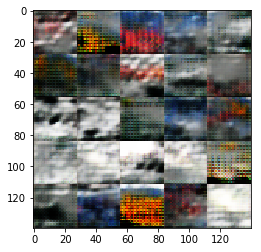

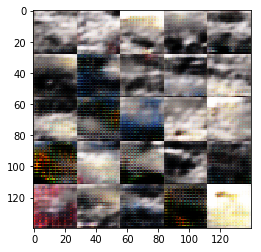

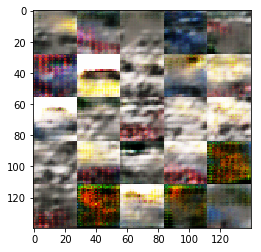

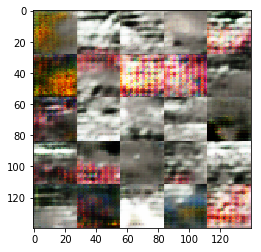

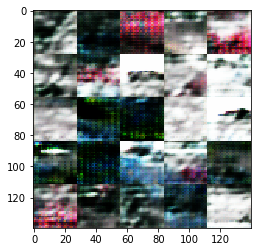

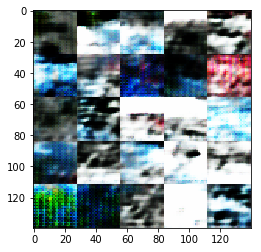

Epoch 34/50... Batch 20... Discriminator Loss: 1.1496... Generator Loss: 1.1762


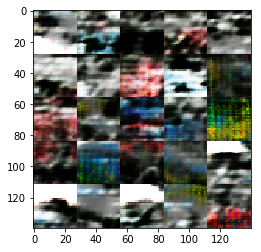

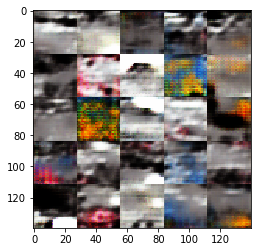

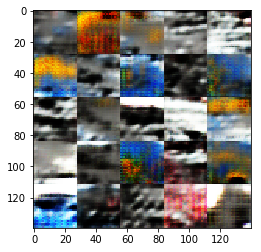

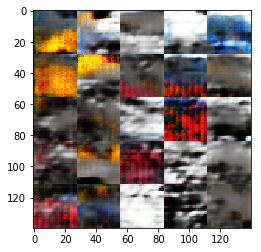

Epoch 34/50... Batch 40... Discriminator Loss: 1.5888... Generator Loss: 0.5185


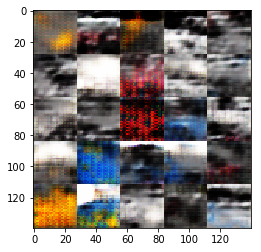

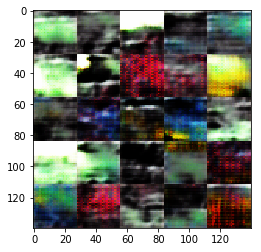

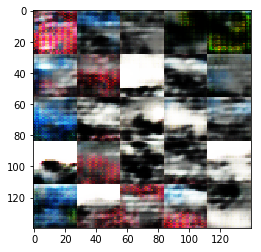

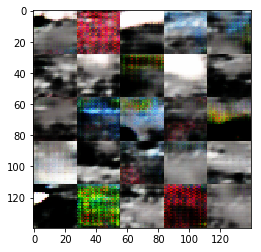

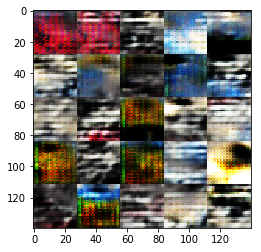

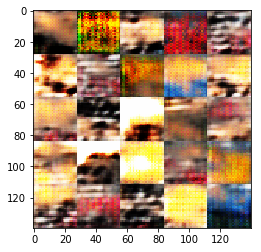

Epoch 35/50... Batch 20... Discriminator Loss: 0.6922... Generator Loss: 2.8614


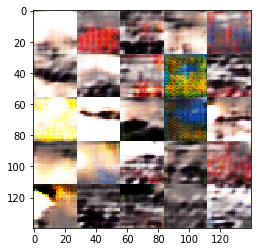

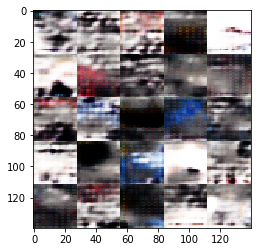

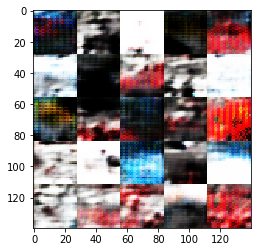

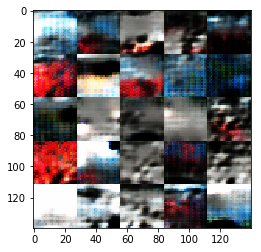

Epoch 35/50... Batch 40... Discriminator Loss: 0.4989... Generator Loss: 2.7286


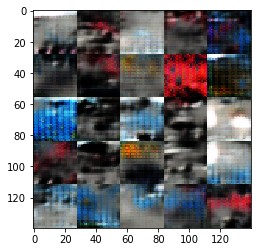

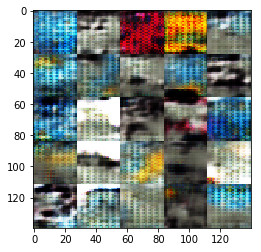

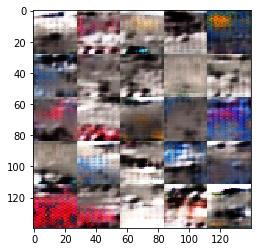

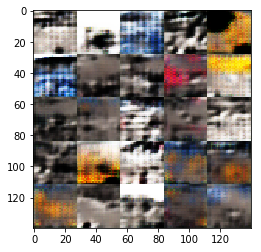

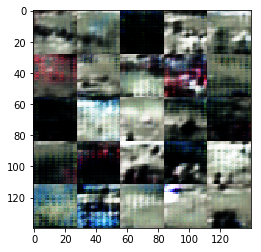

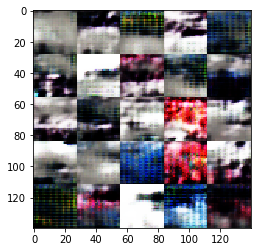

Epoch 36/50... Batch 20... Discriminator Loss: 0.5613... Generator Loss: 2.3986


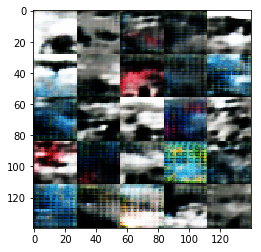

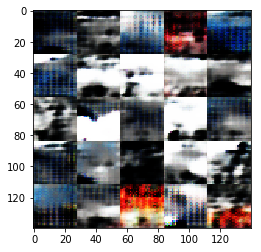

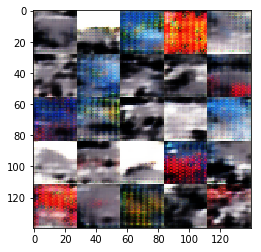

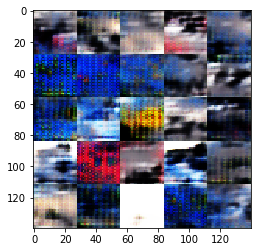

Epoch 36/50... Batch 40... Discriminator Loss: 0.5014... Generator Loss: 2.5040


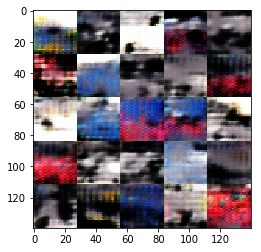

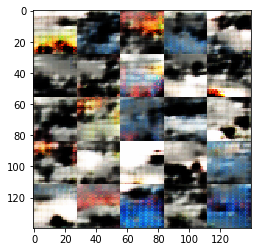

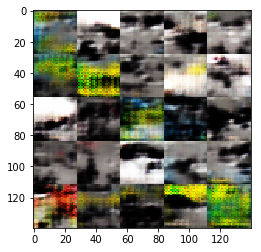

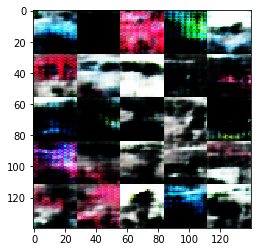

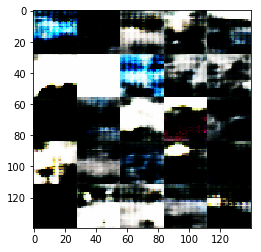

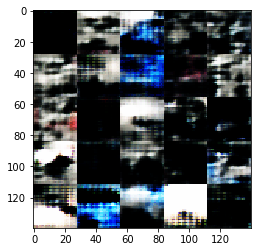

Epoch 37/50... Batch 20... Discriminator Loss: 0.4515... Generator Loss: 4.0338


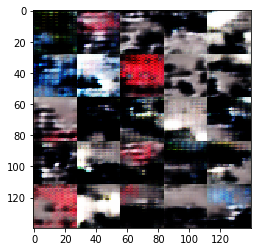

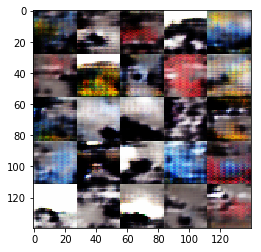

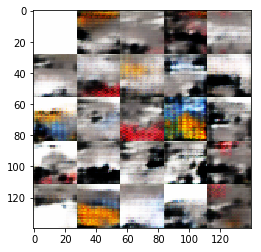

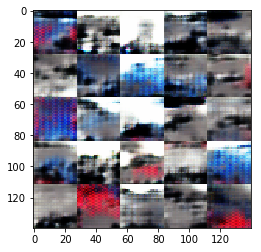

Epoch 37/50... Batch 40... Discriminator Loss: 0.4480... Generator Loss: 3.3343


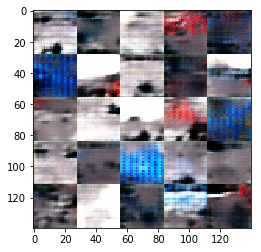

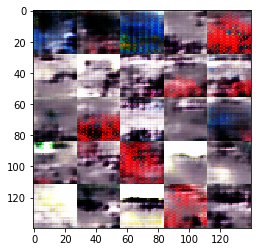

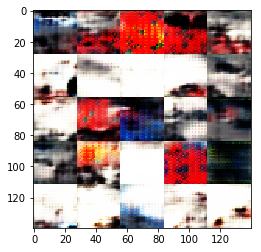

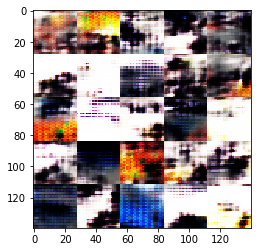

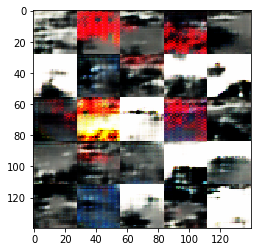

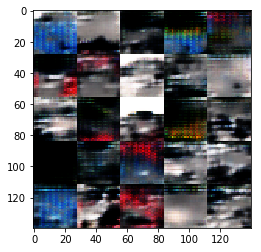

Epoch 38/50... Batch 20... Discriminator Loss: 0.4342... Generator Loss: 3.6109


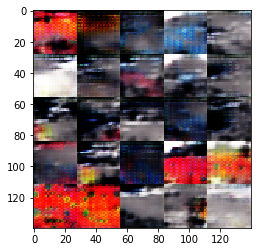

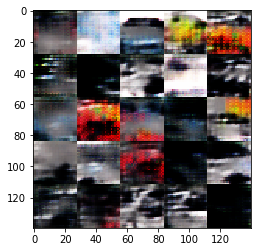

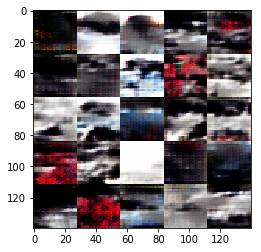

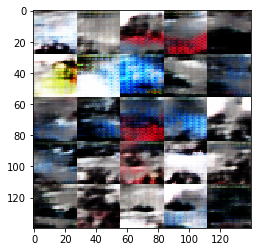

Epoch 38/50... Batch 40... Discriminator Loss: 0.4230... Generator Loss: 4.3178


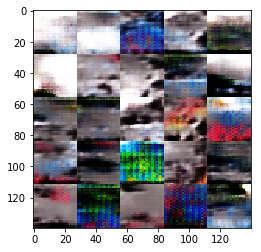

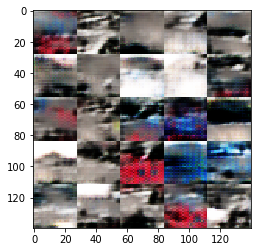

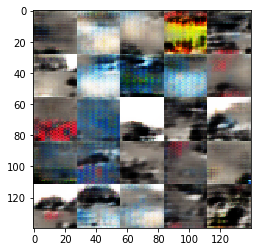

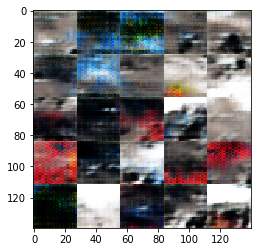

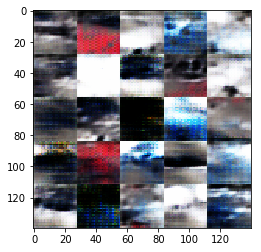

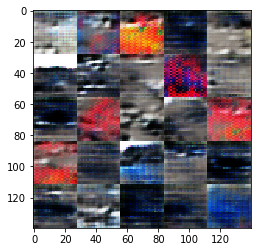

Epoch 39/50... Batch 20... Discriminator Loss: 0.5956... Generator Loss: 2.3827


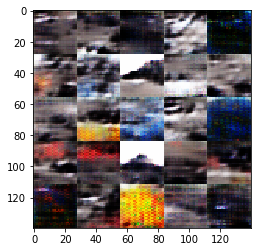

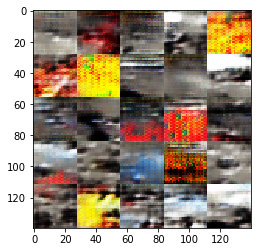

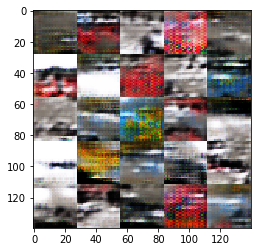

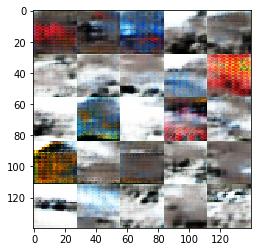

Epoch 39/50... Batch 40... Discriminator Loss: 0.7158... Generator Loss: 1.5488


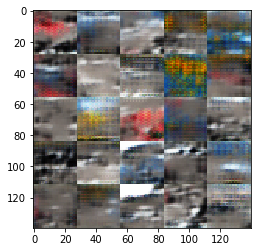

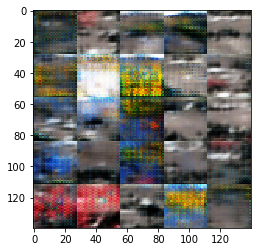

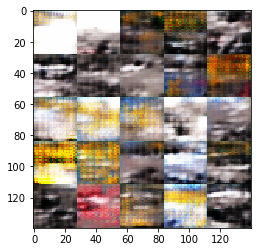

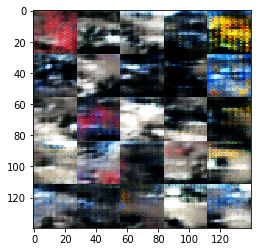

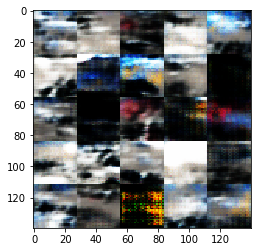

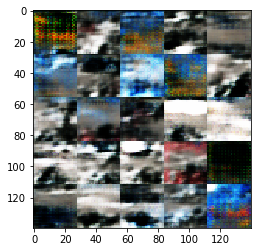

Epoch 40/50... Batch 20... Discriminator Loss: 0.4876... Generator Loss: 2.9917


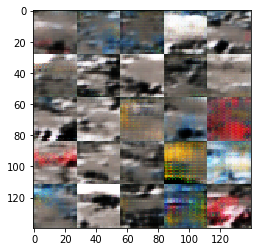

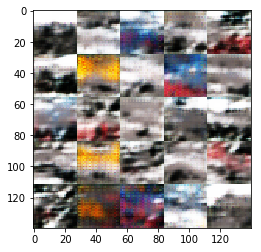

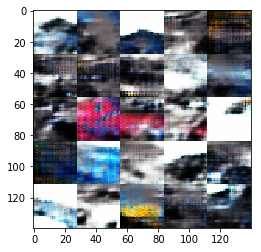

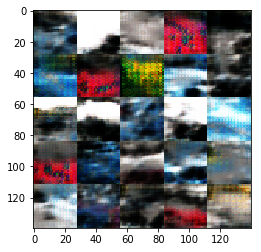

Epoch 40/50... Batch 40... Discriminator Loss: 0.4992... Generator Loss: 4.9507


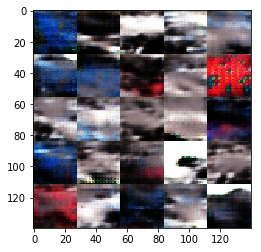

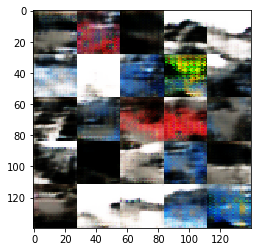

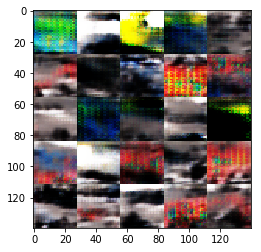

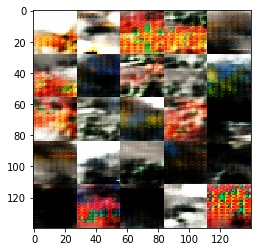

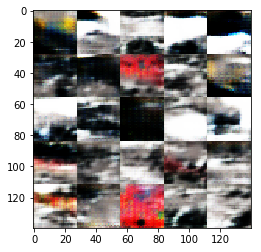

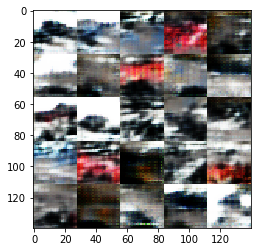

Epoch 41/50... Batch 20... Discriminator Loss: 0.6331... Generator Loss: 2.2173


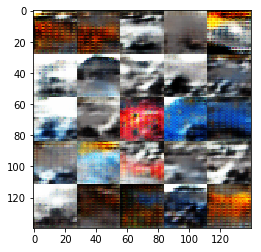

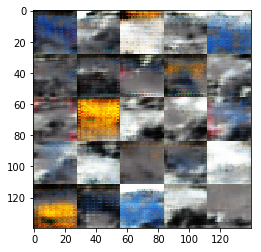

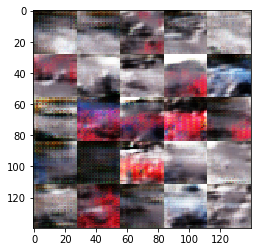

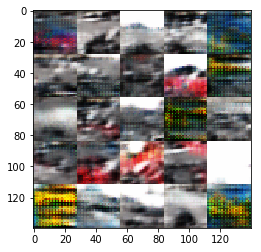

Epoch 41/50... Batch 40... Discriminator Loss: 0.4979... Generator Loss: 2.1843


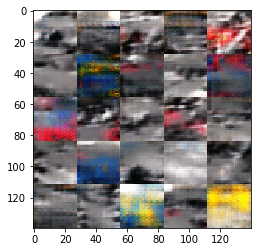

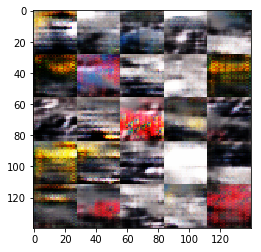

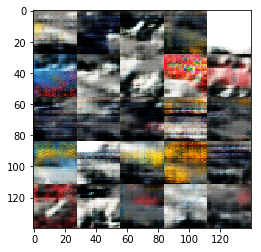

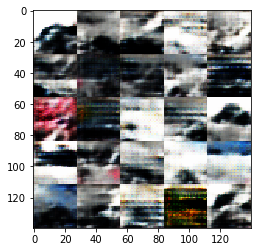

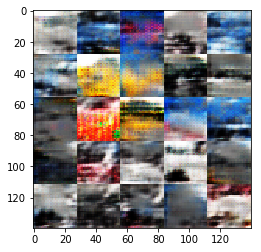

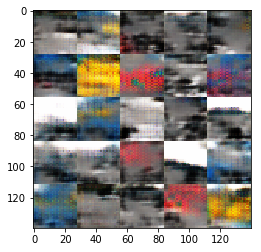

Epoch 42/50... Batch 20... Discriminator Loss: 0.6249... Generator Loss: 2.1178


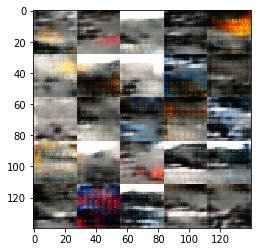

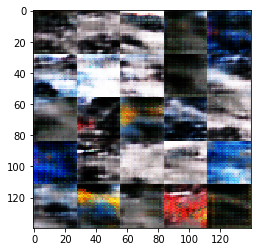

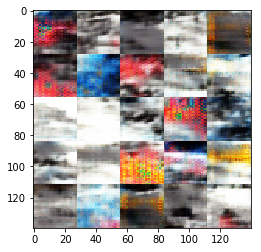

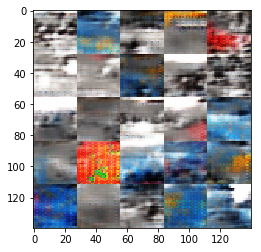

Epoch 42/50... Batch 40... Discriminator Loss: 0.4842... Generator Loss: 3.0483


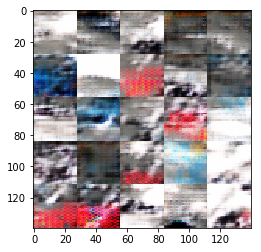

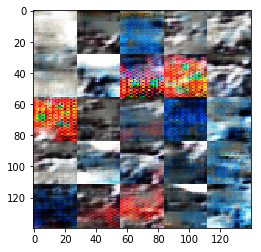

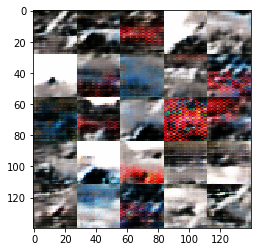

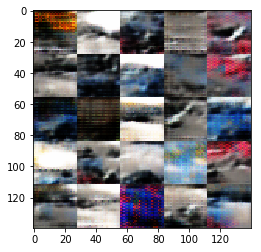

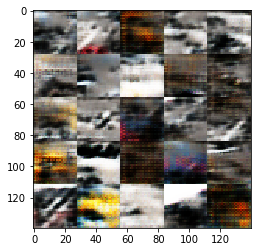

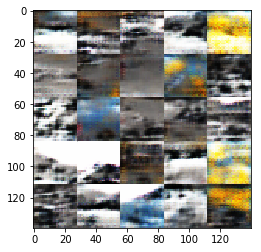

Epoch 43/50... Batch 20... Discriminator Loss: 0.4519... Generator Loss: 3.2256


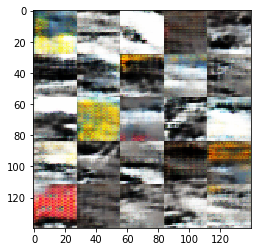

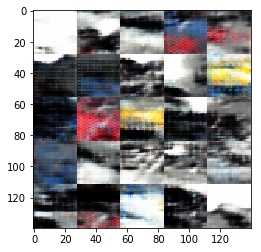

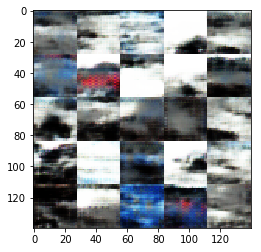

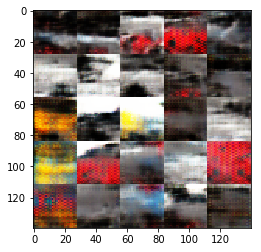

Epoch 43/50... Batch 40... Discriminator Loss: 0.4896... Generator Loss: 2.2861


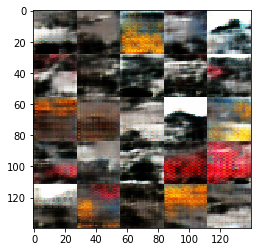

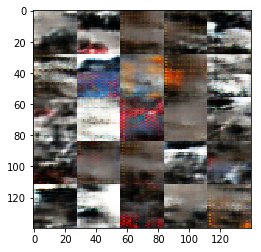

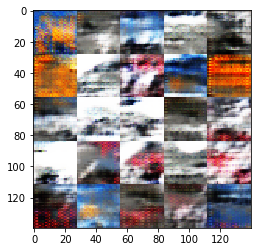

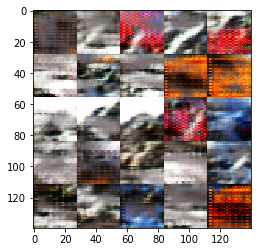

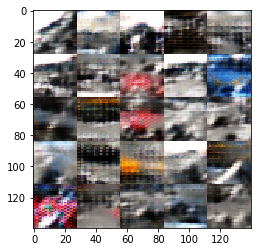

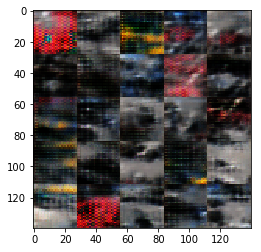

Epoch 44/50... Batch 20... Discriminator Loss: 0.6934... Generator Loss: 2.9303


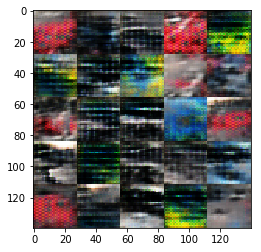

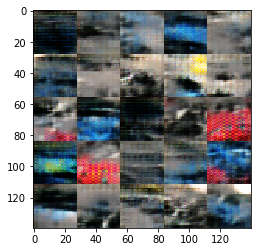

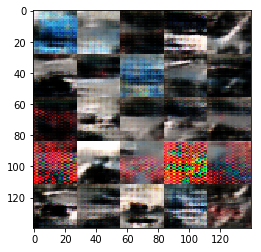

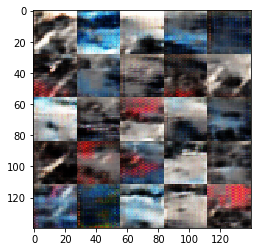

Epoch 44/50... Batch 40... Discriminator Loss: 0.5233... Generator Loss: 2.2255


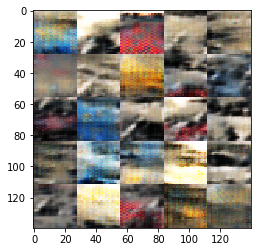

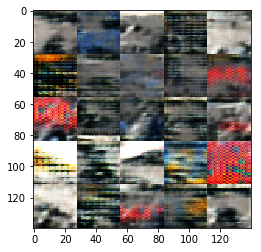

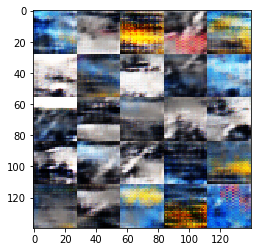

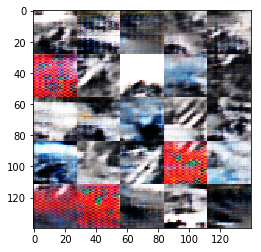

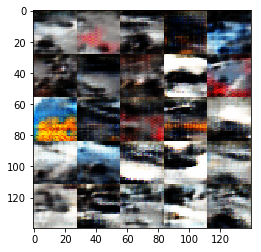

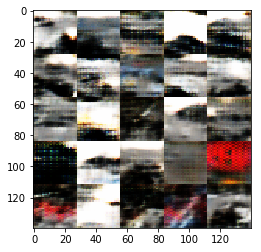

Epoch 45/50... Batch 20... Discriminator Loss: 0.5620... Generator Loss: 2.8801


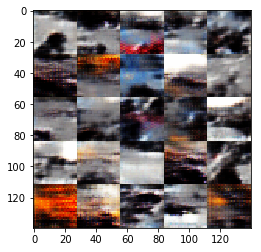

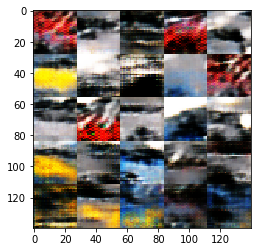

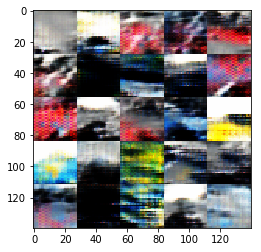

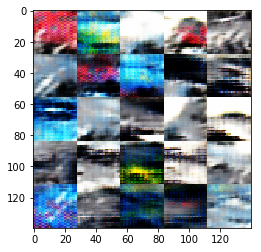

Epoch 45/50... Batch 40... Discriminator Loss: 0.8543... Generator Loss: 1.4699


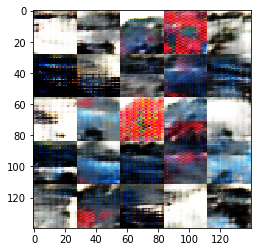

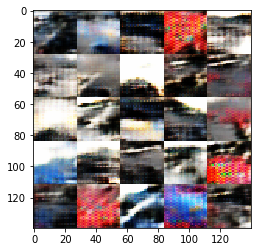

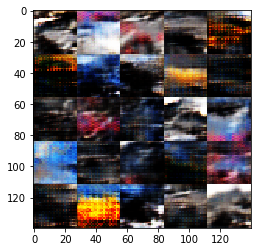

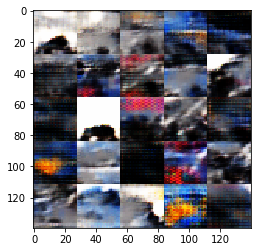

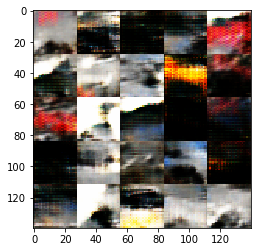

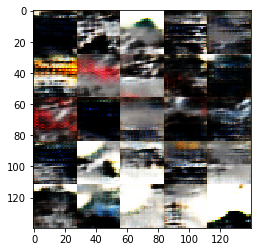

Epoch 46/50... Batch 20... Discriminator Loss: 0.6620... Generator Loss: 2.0634


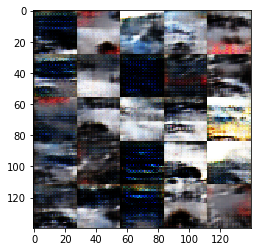

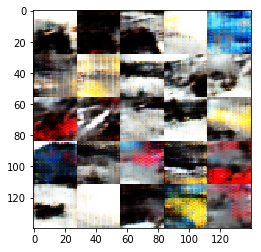

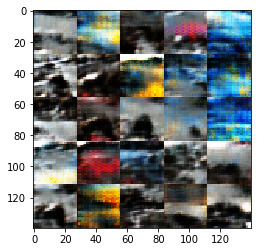

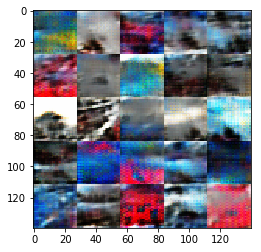

Epoch 46/50... Batch 40... Discriminator Loss: 0.6336... Generator Loss: 1.8722


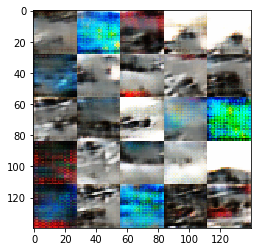

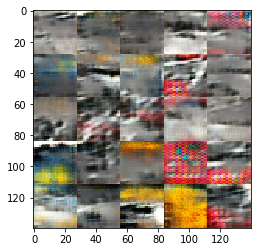

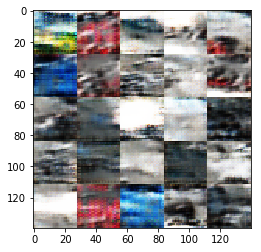

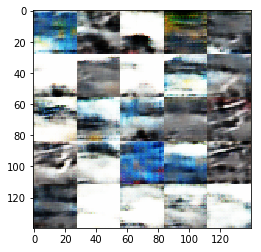

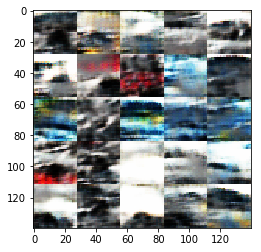

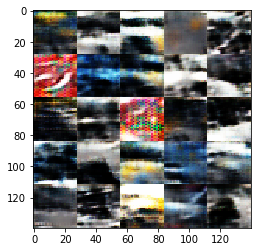

Epoch 47/50... Batch 20... Discriminator Loss: 0.7258... Generator Loss: 1.8632


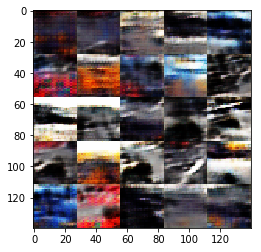

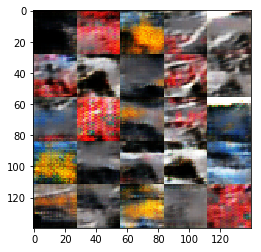

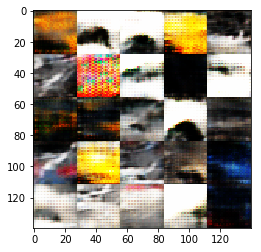

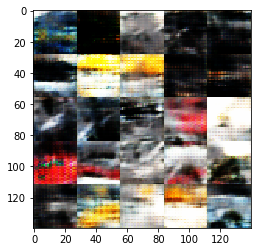

Epoch 47/50... Batch 40... Discriminator Loss: 0.6346... Generator Loss: 1.4004


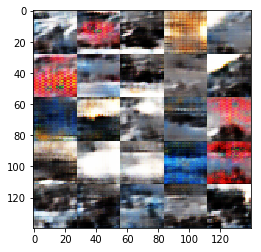

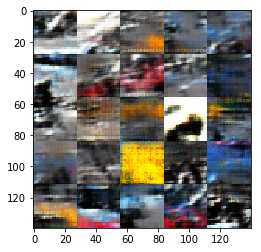

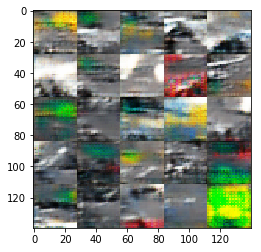

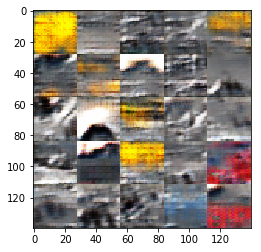

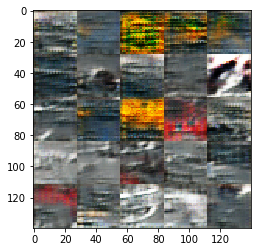

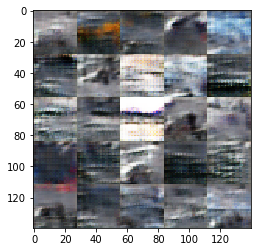

Epoch 48/50... Batch 20... Discriminator Loss: 0.4305... Generator Loss: 2.6257


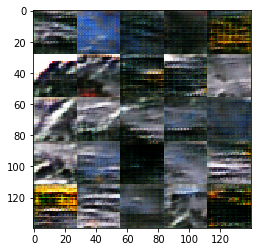

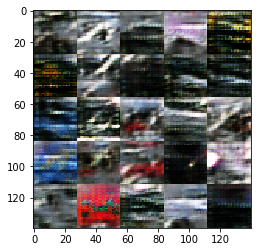

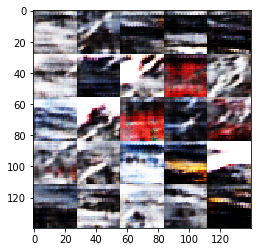

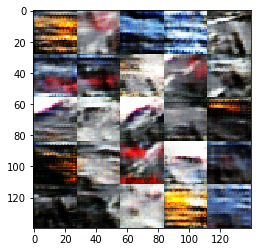

Epoch 48/50... Batch 40... Discriminator Loss: 0.6095... Generator Loss: 2.5280


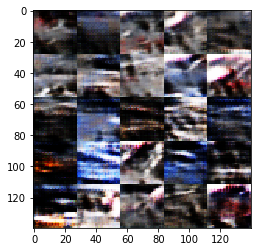

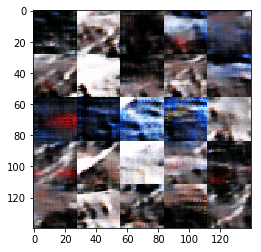

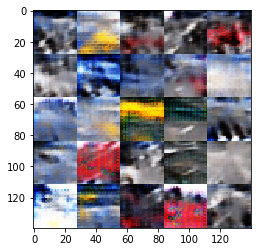

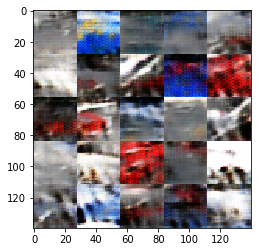

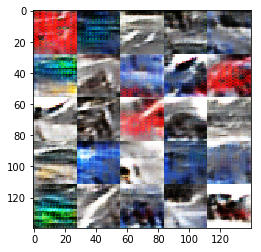

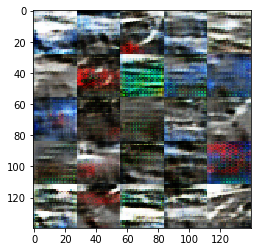

Epoch 49/50... Batch 20... Discriminator Loss: 0.6592... Generator Loss: 2.2118


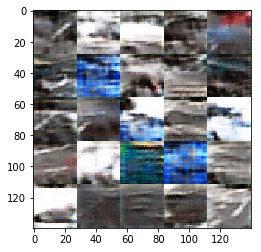

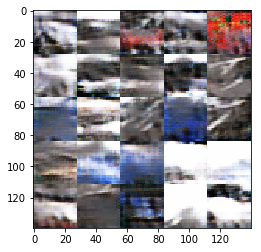

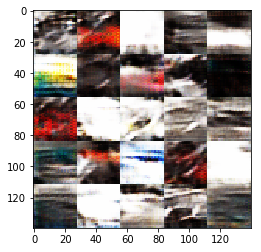

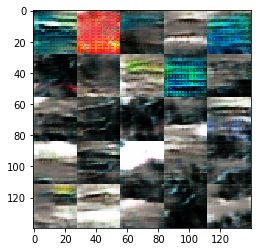

Epoch 49/50... Batch 40... Discriminator Loss: 0.4433... Generator Loss: 3.0644


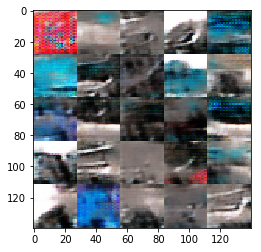

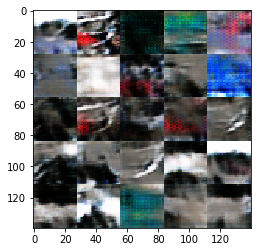

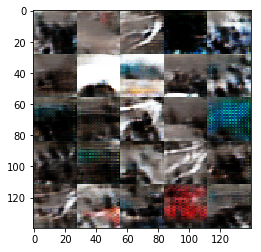

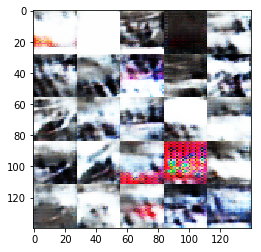

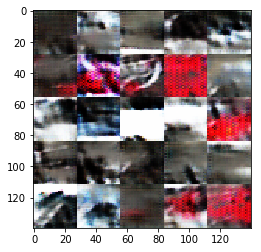

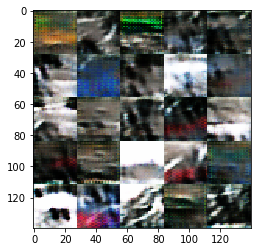

Epoch 50/50... Batch 20... Discriminator Loss: 0.7694... Generator Loss: 2.3654


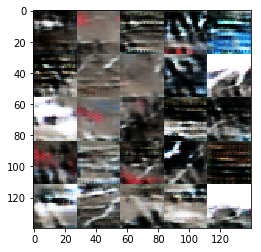

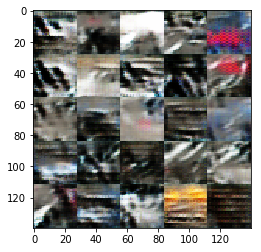

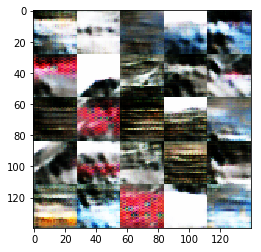

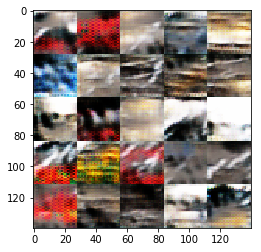

Epoch 50/50... Batch 40... Discriminator Loss: 0.4460... Generator Loss: 2.9638


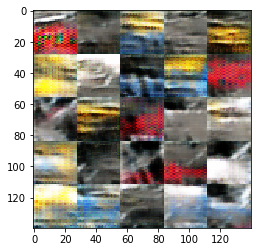

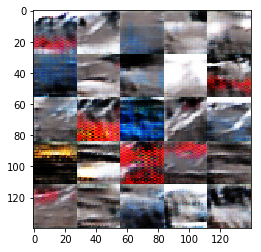

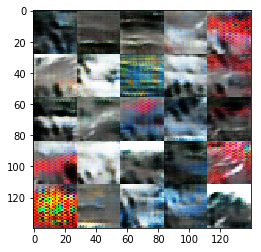

In [14]:
batch_size = 32
z_dim = 100
learning_rate = 0.005
beta1 = 0.4
epochs = 50

renault_dataset = helper.Dataset('renault', glob(os.path.join(data_dir, 'renault/*.jpg')))
with tf.Graph().as_default():
    dis, gen, f1 = train(epochs, batch_size, z_dim, learning_rate, beta1, renault_dataset.get_batches,
          renault_dataset.shape, renault_dataset.image_mode)

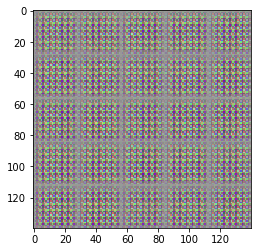

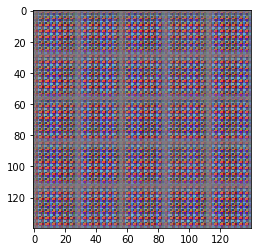

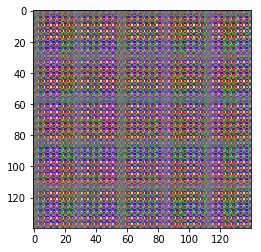

Epoch 1/100... Batch 20... Discriminator Loss: 0.3674... Generator Loss: 5.3036


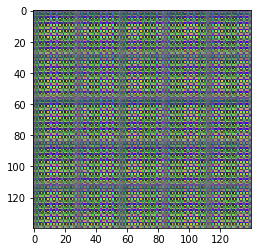

/Users/az02210/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:742: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


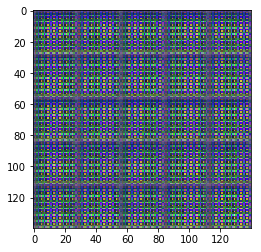

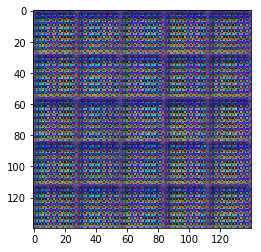

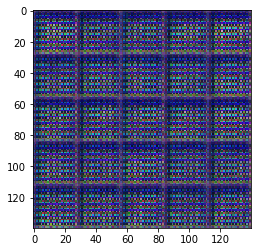

Epoch 1/100... Batch 40... Discriminator Loss: 0.4988... Generator Loss: 2.7826


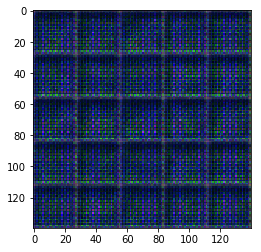

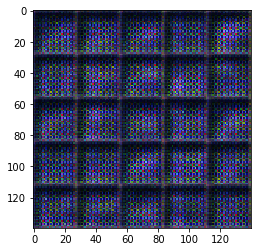

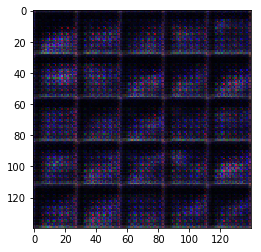

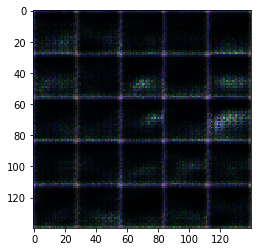

Epoch 1/100... Batch 60... Discriminator Loss: 1.9617... Generator Loss: 0.5016


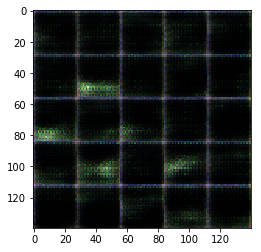

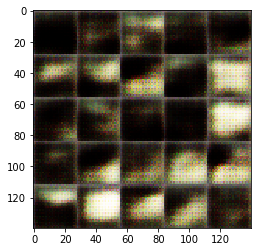

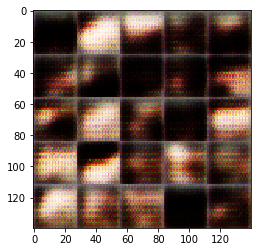

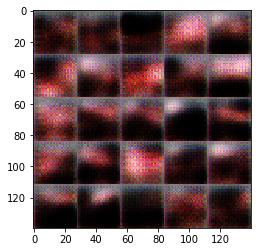

Epoch 1/100... Batch 80... Discriminator Loss: 1.1674... Generator Loss: 1.1382


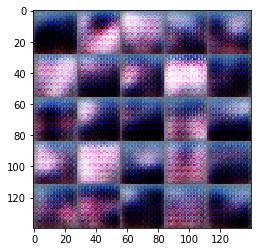

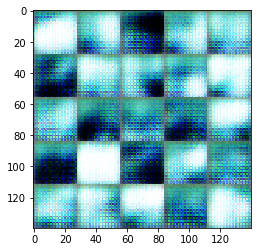

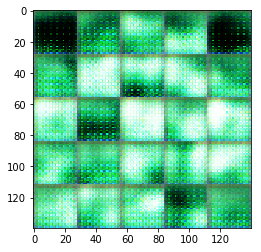

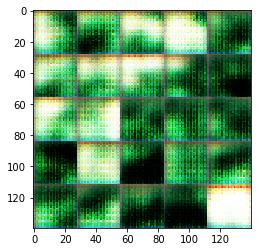

Epoch 1/100... Batch 100... Discriminator Loss: 0.7004... Generator Loss: 2.1959


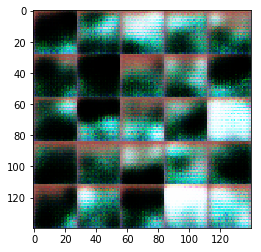

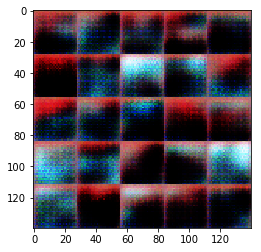

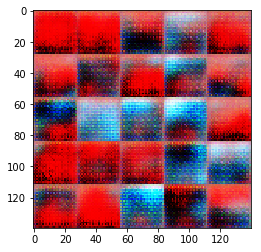

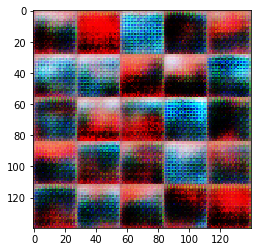

Epoch 1/100... Batch 120... Discriminator Loss: 0.7622... Generator Loss: 1.6735


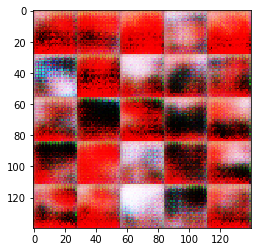

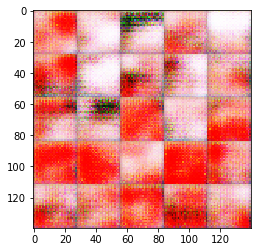

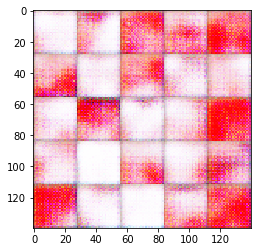

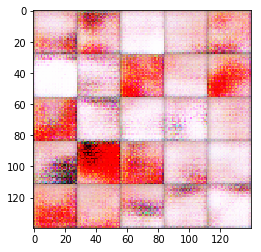

Epoch 1/100... Batch 140... Discriminator Loss: 1.2836... Generator Loss: 0.8829


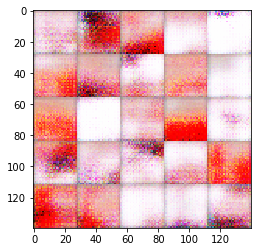

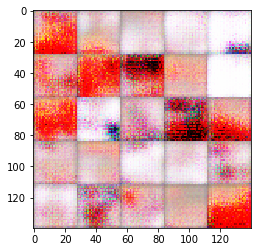

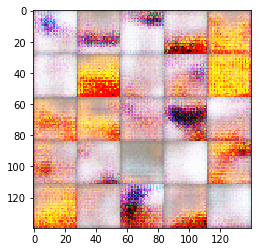

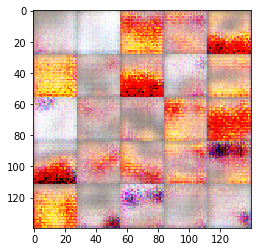

Epoch 1/100... Batch 160... Discriminator Loss: 1.3731... Generator Loss: 1.2467


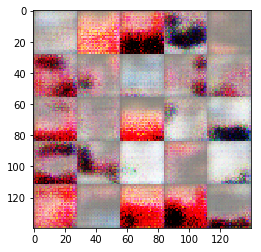

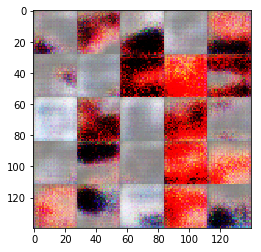

OSError: cannot identify image file '../data/cars/train-images-idx3-ubyte.gz'

In [16]:
batch_size = 64
z_dim = 200
learning_rate = 0.0005
beta1 = 0.4
epochs = 100

renault_dataset = helper.Dataset('renault', glob(os.path.join(data_dir, 'cars/*')))
with tf.Graph().as_default():
    dis, gen, f1 = train(epochs, batch_size, z_dim, learning_rate, beta1, renault_dataset.get_batches,
          renault_dataset.shape, renault_dataset.image_mode)

## Show Loss function

In [ ]:
import matplotlib.pyplot as plt

plt.plot(dis)
plt.show()
plt.plot(gen)
plt.show()
plt.plot(f1)
plt.show()

idx = f1.index(min(f1))
print(dis[idx], gen[idx])